<div class="alert alert-block alert-info">
<center> <h1> MACHINE LEARNING - PROJECT </h1> </center> <br>
<center> 2022/2023 </center>

**Table of Contents** <br>
* [1. Imports](#imports)
    * [1.1. Import Libraries](#importlibraries)
    * [1.2. Import Data](#importdata)
* [2. Data Exploration](#dataexploration)
* [3. Data Pre-Processing](#preprocessing)
    * [3.1. Inconsistencies/Incoherences](#incoherences)
    * [3.2. Encoding the Categorical Variables](#encoding)
    * [3.3. Preparing the Data](#preparation)
    * [3.4. Filling in Missing Values](#missingvalues)
        * [3.4.1. Mode](#mode)
        * [3.4.2. KNN with weights = 'uniform'](#KNN_uniform)
        * [3.4.3. KNN with weights = 'distance'](#KNN_distance)
        * [3.4.4. Iterative Imputer using Logistic Regression](#logistic_reg)
        * [3.4.5. Iterative Imputer using Random Forest Classifier](#RandForestClass)
    * [3.5. Outliers](#outliers)
        * [3.5.1. Manual Filter](#manual)
        * [3.5.2 IQR](#IQR)
        * [3.5.3. Manual & IQR](#manual_IQR)
        * [3.5.4. Z-Score](#zscore)
        * [3.5.5. DBSCAN](#dbscan)
        * [3.5.6. Isolation Forest](#isol_forest)
    * [3.6. Analysis of the dataset after outlier detection and data imputation](#analysis)
* [4. Feature Engineering](#feat_engineering)
* [5. Feature Selection](#feat_selection)
    * [5.1. Filter Methods](#filter_methods)
        * [5.1.1. Spearman Correlation](#spearman)
        * [5.1.2. Variance of the numerical variables](#variance)
        * [5.1.3. ANOVA](#anova)
        * [5.1.4. Kendall's](#kendalls)
        * [5.1.5. Value Counts for each Categorical Variable](#value_counts)
        * [5.1.6. Chi-Squared](#chi_squared)
    * [5.2. Wrapper Methods](#wrapper_methods)
        * [5.2.1. Recursive Feature Elimination with Cross Validation (RFECV) using Logistic Regression](#RFECV_log)
        * [5.2.2. Recursive Feature Elimination with Cross Validation (RFECV) using Random Forest](#RFECV_RF)
    * [5.3. Embedded Methods](#embedded_methods)
        * [5.3.1. Lasso Regression with Cross Validation](#lasso)
        * [5.3.2. Ridge Regression with Cross Validation](#ridge)
        * [5.3.3. Gini Importance and Entropy Importance](#gini/entropy)
    * [5.4. Conclusions](#conclusions)
* [6. Modelling](#modelling)
    * [6.1. Logistic Regression](#log_reg)
    * [6.2. Logistic Regression using Polynomial Features](#log_reg_pol)
    * [6.3. Gaussian Naive Bayes](#naive_bayes)
        * [6.3.1. Gaussian Naive Bayes](#num_naive_bayes)
        * [6.3.2. Categorical Naive Bayes](#cat_naive_bayes)
    * [6.4. Instance Based Learning (KNN Classifier)](#inst_based_learning)
    * [6.5. Neural Networks (MLP Classifier)](#neural_networks)
    * [6.6. Gradient Boosting](#gradient_boosting)
    * [6.7. AdaBoost Classifier](#adaboost)
    * [6.8. Ridge Classifier](#ridge_model)
    * [6.9. Passive Aggressive Classifier](#passive_aggressive)
    * [6.10. Decision Trees Classifier](#DT_classifier)
    * [6.11. Random Forest Classifier](#RF_classifier)
    * [6.12. Bagging Classifier](#bagging_classifier)
        * [6.12.1. base_estimator = default (default = None | DecisionTreeClassifier)](#estimator_DT)
        * [6.12.2. base_estimator = KNN](#estimator_KNN)
        * [6.12.3. base_estimator = LogisticRegression](#estimator_lr)
    * [6.13. Support Vector Machine](#svm)
    * [6.14. Stacking Classifier](#stacking)
        * [6.14.1. Support Vector Machine, Gradient Boosting and Adaboosting as estimators](#sc_1)
        * [6.14.2. Support Vector Machine and KNN as estimators](#sc_2)
        * [6.14.3. Support Vector Machine, KNN and Decision Tree as estimators](#sc_3)
    * [6.15. Voting Classifier](#voting)
        * [6.15.1. Support Vector Machine and Decision Tree as estimators](#sv_1)
        * [6.15.2. KNN and Decision Tree as estimators](#sv_2)
* [7. Models Comparison](#comparison)
* [8. Final Model](#final_model)

<hr>
<a class="anchor" id="imports">
    
# 1. Imports
    
</a>

<a class="anchor" id="importlibraries">

## 1.1. Import Libraries

</a>

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
import math

from math import ceil
from statsmodels.formula.api import ols
from datetime import datetime
from pandas_profiling import ProfileReport
from sklearn.cluster import DBSCAN
from sklearn.linear_model import LogisticRegression, LassoCV, RidgeCV, RidgeClassifier, PassiveAggressiveClassifier
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import KNNImputer,IterativeImputer
from sklearn.preprocessing import OneHotEncoder,MinMaxScaler,StandardScaler,PolynomialFeatures,RobustScaler
from sklearn.ensemble import RandomForestClassifier,IsolationForest,GradientBoostingClassifier,AdaBoostClassifier,BaggingClassifier,StackingClassifier,VotingClassifier
from sklearn.feature_selection import RFECV
from sklearn.neighbors import NearestNeighbors, KNeighborsClassifier
from sklearn.model_selection import StratifiedKFold,GridSearchCV,cross_validate
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import GaussianNB,CategoricalNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
import scipy.stats as stats
from scipy.stats import chi2_contingency

import warnings
warnings.filterwarnings('ignore')

<a class="anchor" id="importdata">

## 1.2. Import Data

</a>

In [2]:
# To read in jupyter
train_demo = pd.read_excel('data/train_demo.xlsx')
train_health = pd.read_excel('data/train_health.xlsx')
train_habits = pd.read_excel('data/train_habits.xlsx') 

test_health = pd.read_excel('data/test_health.xlsx')
test_demo = pd.read_excel('data/test_demo.xlsx')
test_habits = pd.read_excel('data/test_habits.xlsx')

In [3]:
# To read in kaggle

#train_demo=pd.read_excel('/kaggle/input/the-smith-parasite/train_demo.xlsx')
#train_health=pd.read_excel('/kaggle/input/the-smith-parasite/train_health.xlsx')
#train_habits=pd.read_excel('/kaggle/input/the-smith-parasite/train_habits.xlsx') 

#test_demo=pd.read_excel('/kaggle/input/the-smith-parasite/test_demo.xlsx')
#test_health=pd.read_excel('/kaggle/input/the-smith-parasite/test_health.xlsx')
#test_habits=pd.read_excel('/kaggle/input/the-smith-parasite/test_habits.xlsx')

<hr>
<a class="anchor" id="dataexploration">
    
# 2. Data Exploration
    
</a>

#### Checking if 'PatientID' is the same in each dataset

In [4]:
# training sets
train_habits['PatientID'].equals(other=train_health['PatientID']) 
train_habits['PatientID'].equals(other=train_demo['PatientID'])

# test sets
test_habits['PatientID'].equals(other=test_health['PatientID'])
test_habits['PatientID'].equals(other=test_demo['PatientID'])

True

#### Merging the training sets into a dataframe called 'train_data'

In [5]:
train_data=pd.merge(pd.merge(train_habits,train_health,how='inner',on='PatientID'),train_demo,how='inner',on='PatientID').set_index('PatientID')
train_data.head()

,Smoking_Habit,Drinking_Habit,Exercise,Fruit_Habit,Water_Habit,Height,Weight,High_Cholesterol,Blood_Pressure,Mental_Health,Physical_Health,Checkup,Diabetes,Name,Birth_Year,Region,Education,Disease
PatientID,,,,,,,,,,,,,,,,,,
1167,No,I usually consume alcohol every day,Yes,Less than 1. I do not consume fruits every day.,Between one liter and two liters,155,67,358,120,21,2,More than 3 years,Neither I nor my immediate family have diabetes.,Mrs. Stephanie Gay,1965,London,High School Incomplete (10th to 11th grade),1
1805,No,I consider myself a social drinker,Yes,Less than 1. I do not consume fruits every day.,Between one liter and two liters,173,88,230,142,9,0,Not sure,Neither I nor my immediate family have diabetes.,Mr. Sherman Nero,1969,South West,High School Incomplete (10th to 11th grade),1
1557,No,I consider myself a social drinker,No,Less than 1. I do not consume fruits every day.,More than half a liter but less than one liter,162,68,226,122,26,0,More than 3 years,Neither I nor my immediate family have diabetes.,Mr. Mark Boller,1974,Yorkshire and the Humber,Elementary School (1st to 9th grade),1
1658,No,I usually consume alcohol every day,Yes,Less than 1. I do not consume fruits every day.,More than half a liter but less than one liter,180,66,313,125,13,8,Not sure,I have/had pregnancy diabetes or borderline di...,Mr. David Caffee,1958,London,University Complete (3 or more years),0
1544,No,I consider myself a social drinker,No,1 to 2 pieces of fruit in average,More than half a liter but less than one liter,180,58,277,125,18,2,More than 3 years,I have/had pregnancy diabetes or borderline di...,Mr. Gerald Emery,1968,South East,University Incomplete (1 to 2 years),1


#### Merging the test sets into a dataframe called 'test_data'

In [6]:
test_data=pd.merge(pd.merge(test_habits,test_health,how='inner',on='PatientID'),test_demo,how='inner',on='PatientID').set_index('PatientID')
test_data.head()

,Smoking_Habit,Drinking_Habit,Exercise,Fruit_Habit,Water_Habit,Height,Weight,High_Cholesterol,Blood_Pressure,Mental_Health,Physical_Health,Checkup,Diabetes,Name,Birth_Year,Region,Education
PatientID,,,,,,,,,,,,,,,,,
1343,Yes,I usually consume alcohol every day,No,Less than 1. I do not consume fruits every day.,Between one liter and two liters,172,80,203,172,20,2,Not sure,I have/had pregnancy diabetes or borderline di...,Mr. Ricardo Sherman,1970,East Midlands,Elementary School (1st to 9th grade)
1727,No,I consider myself a social drinker,No,Less than 1. I do not consume fruits every day.,More than half a liter but less than one liter,171,80,225,130,21,0,Not sure,I do have diabetes,Mr. Jessie Strickland,1966,Yorkshire and the Humber,University Complete (3 or more years)
1828,No,I usually consume alcohol every day,Yes,Less than 1. I do not consume fruits every day.,Between one liter and two liters,171,78,237,130,24,1,More than 3 years,I have/had pregnancy diabetes or borderline di...,Mr. Robert Foreman,1978,West Midlands,High School Incomplete (10th to 11th grade)
1155,No,I usually consume alcohol every day,No,Less than 1. I do not consume fruits every day.,Less than half a liter,174,87,313,108,19,0,Not sure,I do have diabetes,Mr. Edwin Ferguson,1968,Yorkshire and the Humber,High School Incomplete (10th to 11th grade)
1020,No,I consider myself a social drinker,No,Less than 1. I do not consume fruits every day.,Less than half a liter,172,56,189,140,19,14,More than 3 years,I have/had pregnancy diabetes or borderline di...,Mr. Eliseo Krefft,1962,East Midlands,High School Incomplete (10th to 11th grade)


### Generating a Profile Report to better explore the data

#### Train

In [7]:
ProfileReport(
    train_data,
    title='The Smith Parasite - Training Data',
    correlations={
        "pearson": {"calculate": True},
        "spearman": {"calculate": True},
        "kendall": {"calculate": True},
        "phi_k": {"calculate": True},
        "cramers": {"calculate": True},
    },
)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [8]:
# There are 2 people with the name 'Mr. Gary Miller', but they have diferent information, so it should not be an error
train_data.loc[train_data['Name'] == 'Mr. Gary Miller']

,Smoking_Habit,Drinking_Habit,Exercise,Fruit_Habit,Water_Habit,Height,Weight,High_Cholesterol,Blood_Pressure,Mental_Health,Physical_Health,Checkup,Diabetes,Name,Birth_Year,Region,Education,Disease
PatientID,,,,,,,,,,,,,,,,,,
1221,No,I consider myself a social drinker,No,1 to 2 pieces of fruit in average,Less than half a liter,172,65,258,130,17,6,Not sure,Neither I nor my immediate family have diabetes.,Mr. Gary Miller,1959,North West,University Complete (3 or more years),0
1694,No,I usually consume alcohol every day,No,Less than 1. I do not consume fruits every day.,More than half a liter but less than one liter,178,61,223,118,15,5,Not sure,Neither I nor my immediate family have diabetes.,Mr. Gary Miller,1983,South West,I never attended school / Other,0


#### Test

In [9]:
ProfileReport(
    test_data,
    title='The Smith Parasite - Test Data',
    correlations={
        "pearson": {"calculate": True},
        "spearman": {"calculate": True},
        "kendall": {"calculate": True},
        "phi_k": {"calculate": True},
        "cramers": {"calculate": True},
    },
)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [10]:
# There are 2 people with the name 'Mr. Michael Williams', but they have diferent information, so it should not be an error
test_data.loc[test_data['Name'] == 'Mr. Michael Williams']

,Smoking_Habit,Drinking_Habit,Exercise,Fruit_Habit,Water_Habit,Height,Weight,High_Cholesterol,Blood_Pressure,Mental_Health,Physical_Health,Checkup,Diabetes,Name,Birth_Year,Region,Education
PatientID,,,,,,,,,,,,,,,,,
1740,No,I consider myself a social drinker,No,Less than 1. I do not consume fruits every day.,Less than half a liter,173,79,239,140,24,0,More than 3 years,I have/had pregnancy diabetes or borderline di...,Mr. Michael Williams,1978,North East,Elementary School (1st to 9th grade)
1914,No,I consider myself a social drinker,Yes,1 to 2 pieces of fruit in average,Between one liter and two liters,167,83,216,112,13,0,More than 3 years,Neither I nor my immediate family have diabetes.,Mr. Michael Williams,1956,West Midlands,University Incomplete (1 to 2 years)


### Explore Datatypes

#### Checking the data type of each column

In [11]:
# Train
train_data.dtypes

Smoking_Habit       object
Drinking_Habit      object
Exercise            object
Fruit_Habit         object
Water_Habit         object
Height               int64
Weight               int64
High_Cholesterol     int64
Blood_Pressure       int64
Mental_Health        int64
Physical_Health      int64
Checkup             object
Diabetes            object
Name                object
Birth_Year           int64
Region              object
Education           object
Disease              int64
dtype: object

In [12]:
# Test
test_data.dtypes

Smoking_Habit       object
Drinking_Habit      object
Exercise            object
Fruit_Habit         object
Water_Habit         object
Height               int64
Weight               int64
High_Cholesterol     int64
Blood_Pressure       int64
Mental_Health        int64
Physical_Health      int64
Checkup             object
Diabetes            object
Name                object
Birth_Year           int64
Region              object
Education           object
dtype: object

### Descriptive Statistics

In [13]:
# Train
train_data.describe().T

,count,mean,std,min,25%,50%,75%,max
Height,800.0,167.80625,7.976888,151.0,162.00,167.0,173.0,180.0
Weight,800.0,67.82750,12.113470,40.0,58.00,68.0,77.0,97.0
High_Cholesterol,800.0,249.32250,51.566631,130.0,213.75,244.0,280.0,568.0
Blood_Pressure,800.0,131.05375,17.052693,94.0,120.00,130.0,140.0,200.0
Mental_Health,800.0,17.34500,5.385139,0.0,13.00,18.0,21.0,29.0
Physical_Health,800.0,4.55875,5.449189,0.0,0.00,3.0,7.0,30.0
Birth_Year,800.0,1966.04375,15.421872,1855.0,1961.00,1966.0,1974.0,1993.0
Disease,800.0,0.51375,0.500124,0.0,0.00,1.0,1.0,1.0


In [14]:
# Test
test_data.describe().T

,count,mean,std,min,25%,50%,75%,max
Height,225.0,167.422222,8.014743,151.0,162.0,167.0,173.0,180.0
Weight,225.0,67.800000,12.758750,42.0,57.0,68.0,77.0,97.0
High_Cholesterol,225.0,252.408889,51.727410,135.0,217.0,244.0,278.0,421.0
Blood_Pressure,225.0,133.595556,18.983098,94.0,120.0,130.0,144.0,200.0
Mental_Health,225.0,17.546667,4.902514,3.0,15.0,18.0,22.0,27.0
Physical_Health,225.0,5.377778,6.061032,0.0,0.0,4.0,9.0,30.0
Birth_Year,225.0,1967.644444,9.438607,1945.0,1961.0,1967.0,1975.0,1988.0


<hr>
<a class="anchor" id="preprocessing">
    
# 3. Data Pre-Processing
    
</a>

In [15]:
# Making a copy of 'train_data'
train_data_original=train_data.copy()

# Making a copy of 'test_data'
test_data_original=test_data.copy()

<a class="anchor" id="incoherences">

## 3.1. Inconsistencies/Incoherences

</a>

#### Correcting the values 'LONDON' to 'London' in the column `Region` in the train dataset

In [16]:
train_data.replace("LONDON", 'London', inplace=True)
train_data['Region'].unique()

array(['London', 'South West', 'Yorkshire and the Humber', 'South East',
       'East Midlands', 'West Midlands', 'East of England', 'North West',
       'North East'], dtype=object)

#### Correcting the column `Birth_Year` in the train dataset, assuming that all the values that start with '18' are supposed to start with '19'

In [17]:
# There were only 12 observations that started with 18 and had excessive values (the minimum age was 141 years).
# So we assumed that instead of 18 they meant 19.
def birth_replace(x):
    x=str(x)
    if x[0]=='1' and x[1]=='8':
        x=x[0]+'9'+x[2:]
    else:
        x
    return int(x)

# Correcting the column 'Birth_Year' by applying the function created above
train_data['Birth_Year']=train_data['Birth_Year'].apply(birth_replace)

<a class="anchor" id="encoding">

## 3.2. Encoding the Categorical Variables

</a>

#### Train

In [18]:
# Checkup has a lot of values as 'Not sure' (39%).
# Should we keep the feature? Should we handle 'Not sure' as missing values (being that it could indicate 'negligence')?

# NaNs in 'Education':
# The mode doesn't seem good, especially because the categories have similar values.
# It also doesn't make sense to drop those observations, considering the loss of information.

In [19]:
# We are not using the Ordinal Encoder because that way we couldn't decide which value gets each number

# train_data['Education'].unique()
classification_education={'I never attended school / Other': 0,
                          'Elementary School (1st to 9th grade)': 1,
                          'High School Incomplete (10th to 11th grade)': 2,
                          'High School Graduate': 3,
                          'University Incomplete (1 to 2 years)': 4,
                          'University Complete (3 or more years)': 5
}
# Keeping the Nans in 'Education'
train_data['Education']=train_data['Education'][~train_data['Education'].isnull()].apply(lambda x:classification_education[x])

# train_data['Drinking_Habit'].unique()
classification_drinking={'I do not consume any type of alcohol': 0,
                         'I consider myself a social drinker': 1,
                         'I usually consume alcohol every day': 2
}
train_data['Drinking_Habit']=train_data['Drinking_Habit'].apply(lambda x:classification_drinking[x])

# train_data['Fruit_Habit'].unique()
classification_fruit={'Less than 1. I do not consume fruits every day.': 0,
                      '1 to 2 pieces of fruit in average': 1,
                      '3 to 4 pieces of fruit in average': 2,
                      '5 to 6 pieces of fruit in average': 3,
                      'More than six pieces of fruit': 4
}
train_data['Fruit_Habit']=train_data['Fruit_Habit'].apply(lambda x:classification_fruit[x])

# train_data['Water_Habit'].unique()
classification_water={'Less than half a liter': 0,
                      'More than half a liter but less than one liter': 1,
                      'Between one liter and two liters': 2
}
train_data['Water_Habit']=train_data['Water_Habit'].apply(lambda x:classification_water[x])

In [20]:
# Using OneHotEncoder
oenc = OneHotEncoder(drop='first',sparse=False)
onehot_features = ['Smoking_Habit','Exercise','Region','Checkup','Diabetes']           

ohc_feat = oenc.fit_transform(train_data[onehot_features])
ohc_feat_names = oenc.get_feature_names_out()
ohc_df = pd.DataFrame(data=ohc_feat,columns=ohc_feat_names)
ohc_df.index=train_data.index
train_data = pd.concat([train_data.drop(columns=onehot_features), ohc_df], axis=1)

In [21]:
train_data.head()

,Drinking_Habit,Fruit_Habit,Water_Habit,Height,Weight,High_Cholesterol,Blood_Pressure,Mental_Health,Physical_Health,Name,...,Region_South East,Region_South West,Region_West Midlands,Region_Yorkshire and the Humber,Checkup_Less than three months,Checkup_More than 3 years,Checkup_Not sure,"Diabetes_I don't have diabetes, but I have direct family members who have diabetes.",Diabetes_I have/had pregnancy diabetes or borderline diabetes,Diabetes_Neither I nor my immediate family have diabetes.
PatientID,,,,,,,,,,,,,,,,,,,,,
1167,2,0,2,155,67,358,120,21,2,Mrs. Stephanie Gay,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
1805,1,0,2,173,88,230,142,9,0,Mr. Sherman Nero,...,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
1557,1,0,1,162,68,226,122,26,0,Mr. Mark Boller,...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0
1658,2,0,1,180,66,313,125,13,8,Mr. David Caffee,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
1544,1,1,1,180,58,277,125,18,2,Mr. Gerald Emery,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0


#### Test

In [22]:
# Education
test_data['Education'] = test_data['Education'].apply(lambda x:classification_education[x])

# Drinking_Habit
test_data['Drinking_Habit']=test_data['Drinking_Habit'].apply(lambda x:classification_drinking[x])

# Fruit_Habit
test_data['Fruit_Habit']=test_data['Fruit_Habit'].apply(lambda x:classification_fruit[x])

# Water_Habit
test_data['Water_Habit']=test_data['Water_Habit'].apply(lambda x:classification_water[x])

In [23]:
# Using OneHotEncoder
oenc = OneHotEncoder(drop='first',sparse=False)
# onehot_features = ['Smoking_Habit','Exercise','Region','Checkup','Diabetes']
ohc_feat_test = oenc.fit_transform(test_data[onehot_features])
ohc_feat_names_test = oenc.get_feature_names_out()
ohc_df_test = pd.DataFrame(data=ohc_feat_test,columns=ohc_feat_names_test)
ohc_df_test.index = test_data.index
test_data = pd.concat([test_data.drop(columns=onehot_features), ohc_df_test], axis=1)

In [24]:
test_data.head()

,Drinking_Habit,Fruit_Habit,Water_Habit,Height,Weight,High_Cholesterol,Blood_Pressure,Mental_Health,Physical_Health,Name,...,Region_South East,Region_South West,Region_West Midlands,Region_Yorkshire and the Humber,Checkup_Less than three months,Checkup_More than 3 years,Checkup_Not sure,"Diabetes_I don't have diabetes, but I have direct family members who have diabetes.",Diabetes_I have/had pregnancy diabetes or borderline diabetes,Diabetes_Neither I nor my immediate family have diabetes.
PatientID,,,,,,,,,,,,,,,,,,,,,
1343,2,0,2,172,80,203,172,20,2,Mr. Ricardo Sherman,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
1727,1,0,1,171,80,225,130,21,0,Mr. Jessie Strickland,...,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0
1828,2,0,2,171,78,237,130,24,1,Mr. Robert Foreman,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
1155,2,0,0,174,87,313,108,19,0,Mr. Edwin Ferguson,...,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0
1020,1,0,0,172,56,189,140,19,14,Mr. Eliseo Krefft,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0


<a class="anchor" id="preparation">

## 3.3. Preparing the Data

</a>

Dropping the feature `Name` because it doesn't add any relevant information

In [25]:
# Train
train_data.drop(columns='Name',inplace=True)
# Test
test_data.drop(columns='Name',inplace=True)

### Renaming the columns

#### Train

In [26]:
train_data.columns

Index(['Drinking_Habit', 'Fruit_Habit', 'Water_Habit', 'Height', 'Weight',
       'High_Cholesterol', 'Blood_Pressure', 'Mental_Health',
       'Physical_Health', 'Birth_Year', 'Education', 'Disease',
       'Smoking_Habit_Yes', 'Exercise_Yes', 'Region_East of England',
       'Region_London', 'Region_North East', 'Region_North West',
       'Region_South East', 'Region_South West', 'Region_West Midlands',
       'Region_Yorkshire and the Humber', 'Checkup_Less than three months',
       'Checkup_More than 3 years', 'Checkup_Not sure',
       'Diabetes_I don't have diabetes, but I have direct family members who have diabetes.',
       'Diabetes_I have/had pregnancy diabetes or borderline diabetes',
       'Diabetes_Neither I nor my immediate family have diabetes.'],
      dtype='object')

In [27]:
train_data.rename(columns={'Smoking_Habit_Yes':'Smoking_Habit', 'Exercise_Yes':'Exercise',
                           'Region_East of England':'Region_EastOfEngland', 'Region_North East':'Region_NorthEast',
                           'Region_North West':'Region_NorthWest', 'Region_South East':'Region_SouthEast',
                           'Region_South West':'Region_SouthWest', 'Region_West Midlands':'Region_WestMidlands',
                           'Region_Yorkshire and the Humber':'Region_YorkshireAndTheHumber',
                           'Checkup_Less than three months':'Checkup_LessThan3Months',
                           'Checkup_More than 3 years':'Checkup_MoreThan3Years', 'Checkup_Not sure':'Checkup_NotSure',
                           'Diabetes_Neither I nor my immediate family have diabetes.':'Diabetes_A',
                           "Diabetes_I don't have diabetes, but I have direct family members who have diabetes.":'Diabetes_B',
                           'Diabetes_I have/had pregnancy diabetes or borderline diabetes':'Diabetes_C'}, inplace=True)

#### Test

In [28]:
test_data.rename(columns={'Smoking_Habit_Yes':'Smoking_Habit', 'Exercise_Yes':'Exercise',
                           'Region_East of England':'Region_EastOfEngland', 'Region_North East':'Region_NorthEast',
                           'Region_North West':'Region_NorthWest', 'Region_South East':'Region_SouthEast',
                           'Region_South West':'Region_SouthWest', 'Region_West Midlands':'Region_WestMidlands',
                           'Region_Yorkshire and the Humber':'Region_YorkshireAndTheHumber',
                           'Checkup_Less than three months':'Checkup_LessThan3Months',
                           'Checkup_More than 3 years':'Checkup_MoreThan3Years', 'Checkup_Not sure':'Checkup_NotSure',
                           'Diabetes_Neither I nor my immediate family have diabetes.':'Diabetes_A',
                           "Diabetes_I don't have diabetes, but I have direct family members who have diabetes.":'Diabetes_B',
                           'Diabetes_I have/had pregnancy diabetes or borderline diabetes':'Diabetes_C'}, inplace=True)

### Definition of the Metric and Non-Metric features

In [29]:
metric_features = ['Height','Weight','High_Cholesterol','Blood_Pressure','Mental_Health','Physical_Health','Birth_Year']
non_metric_features = ['Drinking_Habit', 'Fruit_Habit', 'Water_Habit', 'Education','Smoking_Habit',
                       'Exercise', 'Region_EastOfEngland', 'Region_London', 'Region_NorthEast', 'Region_NorthWest',
                       'Region_SouthEast', 'Region_SouthWest', 'Region_WestMidlands','Region_YorkshireAndTheHumber',
                       'Checkup_LessThan3Months', 'Checkup_MoreThan3Years', 'Checkup_NotSure', "Diabetes_A", 'Diabetes_B',
                       'Diabetes_C']  

<a class="anchor" id="missingvalues">

## 3.4. Filling in Missing Values

</a>

In [30]:
# Train
train_data.isna().sum()

Drinking_Habit                   0
Fruit_Habit                      0
Water_Habit                      0
Height                           0
Weight                           0
High_Cholesterol                 0
Blood_Pressure                   0
Mental_Health                    0
Physical_Health                  0
Birth_Year                       0
Education                       13
Disease                          0
Smoking_Habit                    0
Exercise                         0
Region_EastOfEngland             0
Region_London                    0
Region_NorthEast                 0
Region_NorthWest                 0
Region_SouthEast                 0
Region_SouthWest                 0
Region_WestMidlands              0
Region_YorkshireAndTheHumber     0
Checkup_LessThan3Months          0
Checkup_MoreThan3Years           0
Checkup_NotSure                  0
Diabetes_B                       0
Diabetes_C                       0
Diabetes_A                       0
dtype: int64

In [31]:
# Test
test_data.isna().sum()  # There are no missing values in the test dataset

Drinking_Habit                  0
Fruit_Habit                     0
Water_Habit                     0
Height                          0
Weight                          0
High_Cholesterol                0
Blood_Pressure                  0
Mental_Health                   0
Physical_Health                 0
Birth_Year                      0
Education                       0
Smoking_Habit                   0
Exercise                        0
Region_EastOfEngland            0
Region_London                   0
Region_NorthEast                0
Region_NorthWest                0
Region_SouthEast                0
Region_SouthWest                0
Region_WestMidlands             0
Region_YorkshireAndTheHumber    0
Checkup_LessThan3Months         0
Checkup_MoreThan3Years          0
Checkup_NotSure                 0
Diabetes_B                      0
Diabetes_C                      0
Diabetes_A                      0
dtype: int64

### Data Visualization

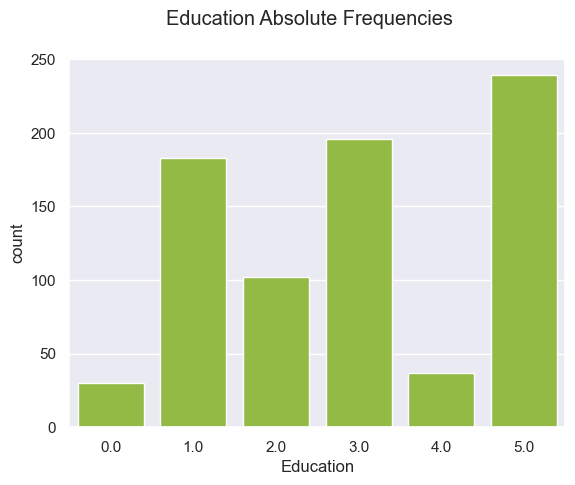

In [32]:
# 'Education'
sns.set() 
sns.countplot(x=train_data["Education"], color='yellowgreen')
plt.suptitle("Education Absolute Frequencies")
plt.show()

### Profile Report

In [33]:
# Train data
ProfileReport(
    train_data,
    title='Updated | The Smith Parasite - Training Data',
    correlations={
        "pearson": {"calculate": True},
        "spearman": {"calculate": True},
        "kendall": {"calculate": False},
        "phi_k": {"calculate": False},
        "cramers": {"calculate": False},
    },                 
)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<a class="anchor" id="mode">

### 3.4.1. Mode

</a>

In [34]:
train_data_mode=train_data.copy()
train_data_mode['Education'].fillna(value=train_data_mode['Education'].mode().values[0],inplace=True)
train_data_mode.drop(columns='Disease',inplace=True)

#### Checking if we have any missing values left

In [35]:
train_data_mode.isna().sum() 

Drinking_Habit                  0
Fruit_Habit                     0
Water_Habit                     0
Height                          0
Weight                          0
High_Cholesterol                0
Blood_Pressure                  0
Mental_Health                   0
Physical_Health                 0
Birth_Year                      0
Education                       0
Smoking_Habit                   0
Exercise                        0
Region_EastOfEngland            0
Region_London                   0
Region_NorthEast                0
Region_NorthWest                0
Region_SouthEast                0
Region_SouthWest                0
Region_WestMidlands             0
Region_YorkshireAndTheHumber    0
Checkup_LessThan3Months         0
Checkup_MoreThan3Years          0
Checkup_NotSure                 0
Diabetes_B                      0
Diabetes_C                      0
Diabetes_A                      0
dtype: int64

<a class="anchor" id="KNN_uniform">

### 3.4.2. KNN with weights = 'uniform'

</a>

In [36]:
features_KNN=metric_features.copy()
features_KNN.append('Education')

In [37]:
train_data_KNN=train_data.loc[:, features_KNN]

In [38]:
# Scale the data
scaler=MinMaxScaler() 
scaled_feat=scaler.fit_transform(train_data_KNN[metric_features])
train_data_KNN.loc[:,metric_features]=scaled_feat

In [39]:
# Applying the KNN
train_data_KNN1=train_data_KNN.copy()
imputer = KNNImputer(n_neighbors=5, weights="uniform") 
result = imputer.fit_transform(train_data_KNN1)
train_data_KNN1=pd.DataFrame(result,columns=train_data_KNN1.columns,index=train_data_KNN.index)
train_data_KNN1['Education']=train_data_KNN1['Education'].round() #because education is an ordinal variable
train_data_KNN1=train_data_KNN1.join(train_data[non_metric_features].loc[:,np.bitwise_and(train_data[non_metric_features].columns!='Education',train_data[non_metric_features].columns!='Disease')])

In [40]:
# Reversing the scaler in order to get the original values back
scaled_feat=scaler.inverse_transform(train_data_KNN[metric_features])
train_data_KNN1.loc[:,metric_features]=scaled_feat

#### Checking if we have any missing values left

In [41]:
train_data_KNN1.isna().sum()

Height                          0
Weight                          0
High_Cholesterol                0
Blood_Pressure                  0
Mental_Health                   0
Physical_Health                 0
Birth_Year                      0
Education                       0
Drinking_Habit                  0
Fruit_Habit                     0
Water_Habit                     0
Smoking_Habit                   0
Exercise                        0
Region_EastOfEngland            0
Region_London                   0
Region_NorthEast                0
Region_NorthWest                0
Region_SouthEast                0
Region_SouthWest                0
Region_WestMidlands             0
Region_YorkshireAndTheHumber    0
Checkup_LessThan3Months         0
Checkup_MoreThan3Years          0
Checkup_NotSure                 0
Diabetes_A                      0
Diabetes_B                      0
Diabetes_C                      0
dtype: int64

<a class="anchor" id="KNN_distance">

### 3.4.3. KNN with weights = 'distance'

</a>

In [42]:
train_data_KNN2=train_data_KNN.copy()
imputer = KNNImputer(n_neighbors=5, weights="distance") 
result = imputer.fit_transform(train_data_KNN2)
train_data_KNN2=pd.DataFrame(result,columns=train_data_KNN2.columns,index=train_data_KNN.index)
train_data_KNN2['Education']=train_data_KNN2['Education'].round() 
train_data_KNN2=train_data_KNN2.join(train_data[non_metric_features].loc[:,np.bitwise_and(train_data[non_metric_features].columns!='Education',train_data[non_metric_features].columns!='Disease')])

In [43]:
# Reversing the scaler in order to get the original values back
scaled_feat=scaler.inverse_transform(train_data_KNN[metric_features])
train_data_KNN2.loc[:,metric_features]=scaled_feat

#### Checking if we have any missing values left

In [44]:
train_data_KNN2.isna().sum()

Height                          0
Weight                          0
High_Cholesterol                0
Blood_Pressure                  0
Mental_Health                   0
Physical_Health                 0
Birth_Year                      0
Education                       0
Drinking_Habit                  0
Fruit_Habit                     0
Water_Habit                     0
Smoking_Habit                   0
Exercise                        0
Region_EastOfEngland            0
Region_London                   0
Region_NorthEast                0
Region_NorthWest                0
Region_SouthEast                0
Region_SouthWest                0
Region_WestMidlands             0
Region_YorkshireAndTheHumber    0
Checkup_LessThan3Months         0
Checkup_MoreThan3Years          0
Checkup_NotSure                 0
Diabetes_A                      0
Diabetes_B                      0
Diabetes_C                      0
dtype: int64

<a class="anchor" id="logistic_reg">

### 3.4.4. Iterative Imputer using Logistic Regression

</a>

In [45]:
# Filtering the variables with correlation to 'Education' higher than 0.055 (abs.)
filter_na_LR=(abs(train_data.corr()['Education'])>0.055) 
remove_na_LR=train_data[(abs(train_data.corr()['Education'])<0.055)[abs(train_data.corr()['Education'])<0.055].index]
train_data_LR=train_data[filter_na_LR[filter_na_LR].index] 
# needed a stronger filtering in order to converge

In [46]:
lr=LogisticRegression(max_iter=5000)
imp=IterativeImputer(estimator=lr,max_iter=5000)
train_data_LR=pd.DataFrame(data=imp.fit_transform(train_data_LR),columns=train_data_LR.columns,index=train_data_LR.index)
train_data_LR=train_data_LR.join(remove_na_LR)
train_data_LR.drop(columns='Disease',inplace=True)

#### Checking if we have any missing values left

In [47]:
train_data_LR.isna().sum()

Fruit_Habit                     0
High_Cholesterol                0
Mental_Health                   0
Education                       0
Smoking_Habit                   0
Region_EastOfEngland            0
Region_WestMidlands             0
Checkup_LessThan3Months         0
Drinking_Habit                  0
Water_Habit                     0
Height                          0
Weight                          0
Blood_Pressure                  0
Physical_Health                 0
Birth_Year                      0
Exercise                        0
Region_London                   0
Region_NorthEast                0
Region_NorthWest                0
Region_SouthEast                0
Region_SouthWest                0
Region_YorkshireAndTheHumber    0
Checkup_MoreThan3Years          0
Checkup_NotSure                 0
Diabetes_B                      0
Diabetes_C                      0
Diabetes_A                      0
dtype: int64

<a class="anchor" id="RandForestClass">

### 3.4.5. Iterative Imputer using Random Forest Classifier

</a>

In [48]:
filter_na_RF=(abs(train_data.corr()['Education'])>0.01)
remove_na_RF=train_data[(abs(train_data.corr()['Education'])<0.01)[abs(train_data.corr()['Education'])<0.01].index]
train_data_RF=train_data.loc[:, filter_na_RF[filter_na_RF].index]
train_data_RF.drop(columns='Disease',inplace=True)

In [49]:
imp_cat = IterativeImputer(estimator=RandomForestClassifier(), initial_strategy='most_frequent',max_iter=100, random_state=10)
train_data_RF=pd.DataFrame(data=imp_cat.fit_transform(train_data_RF),columns=train_data_RF.columns,index=train_data_RF.index)
train_data_RF=train_data_RF.join(remove_na_RF)

#### Checking if we have any missing values left

In [50]:
train_data_RF.isna().sum()

Drinking_Habit                  0
Fruit_Habit                     0
Water_Habit                     0
Height                          0
Weight                          0
High_Cholesterol                0
Blood_Pressure                  0
Mental_Health                   0
Physical_Health                 0
Birth_Year                      0
Education                       0
Smoking_Habit                   0
Exercise                        0
Region_EastOfEngland            0
Region_London                   0
Region_NorthWest                0
Region_SouthEast                0
Region_SouthWest                0
Region_WestMidlands             0
Checkup_LessThan3Months         0
Checkup_MoreThan3Years          0
Checkup_NotSure                 0
Diabetes_A                      0
Region_NorthEast                0
Region_YorkshireAndTheHumber    0
Diabetes_B                      0
Diabetes_C                      0
dtype: int64

<a class="anchor" id="outliers">

## 3.5. Outliers

</a>

### Data Visualization

#### Histograms

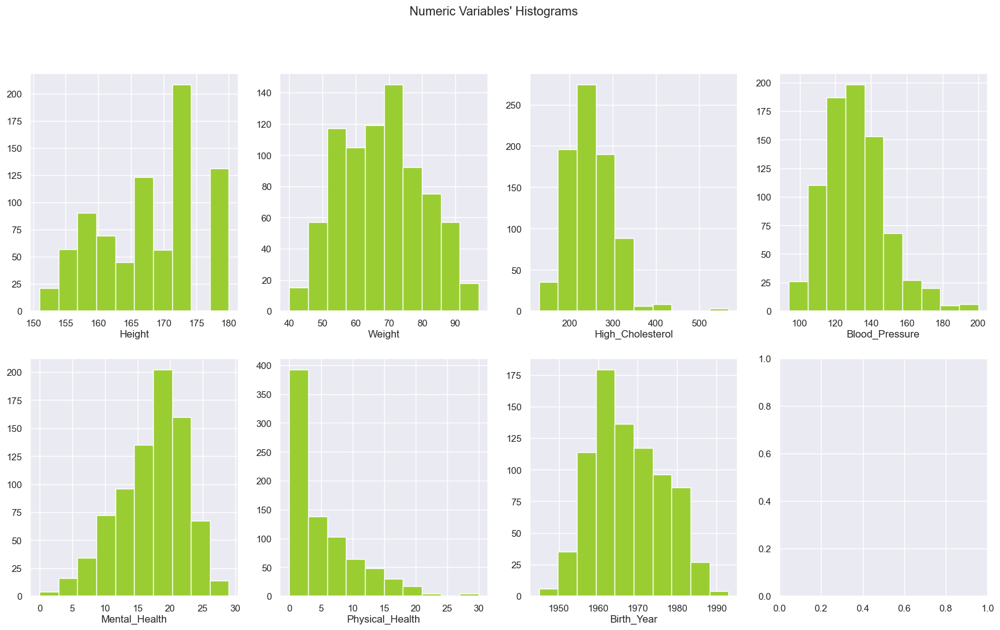

In [51]:
# Metric-features
sns.set()
# Preparing figure (creating individual axes where each histogram will be placed)
fig, axes = plt.subplots(2, ceil(len(metric_features) / 2), figsize=(20, 11))
# Plot data (iterating across axes objects and associate each histogram)
for ax, features in zip(axes.flatten(), metric_features):
    ax.hist(train_data_RF[features], color = 'yellowgreen')
    ax.set_title(features, y=-0.13)
# Layout    
plt.suptitle("Numeric Variables' Histograms")
plt.show()

#### Box Plots

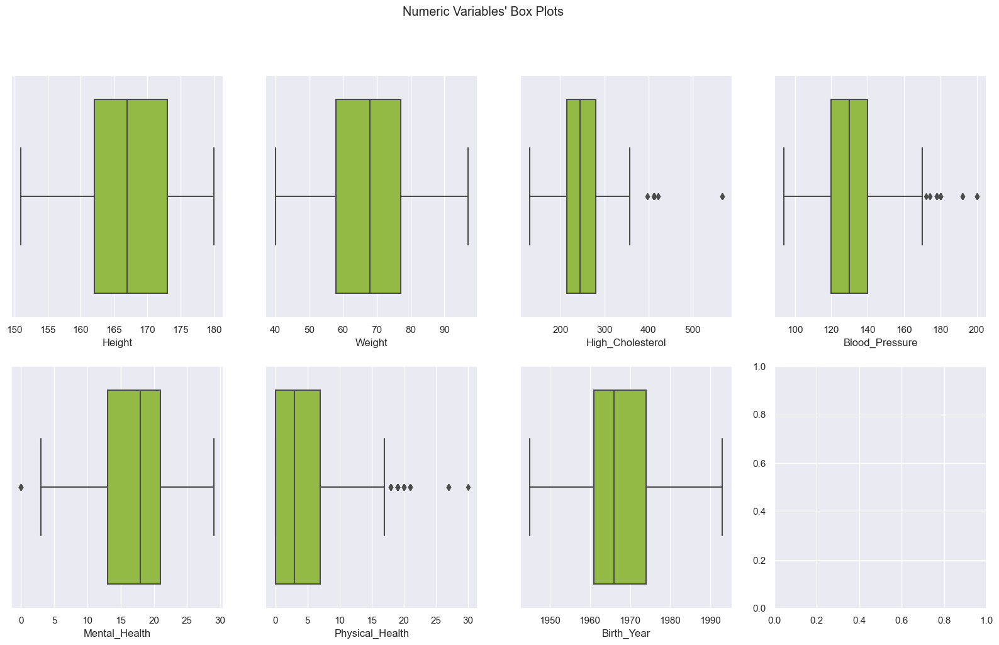

In [52]:
# Metric-features
sns.set()
fig, axes = plt.subplots(2, ceil(len(metric_features) / 2), figsize=(20, 11))
for ax, features in zip(axes.flatten(), metric_features):
    sns.boxplot(x = train_data_RF[features], ax = ax, color = 'yellowgreen')
plt.suptitle("Numeric Variables' Box Plots")
plt.show()

<a class="anchor" id="manual">

### 3.5.1. Manual Filter

</a>

In [53]:
filters1 = (
    (train_data_RF['High_Cholesterol']<400)
    &
    (train_data_RF['Blood_Pressure']<192)
    &
    (train_data_RF['Physical_Health']<27)
)
train_data_RF1=train_data_RF[filters1]
print('Percentage of data kept after removing outliers:', np.round(train_data_RF1.shape[0] / train_data_original.shape[0], 4))

Percentage of data kept after removing outliers: 0.9762


<a class="anchor" id="IQR">

### 3.5.2. IQR

</a>

In [54]:
q25 = train_data_RF.quantile(.25)
q75 = train_data_RF.quantile(.75)
iqr = (q75 - q25)

upper_lim = q75 + 2 * iqr    
lower_lim = q25 - 2 * iqr

filters2 = []
for metric in metric_features:
    llim = lower_lim[metric]
    ulim = upper_lim[metric]
    filters2.append(train_data_RF[metric].between(llim, ulim, inclusive='both'))

filters2 = pd.Series(np.all(filters2, 0))
filters2.index=train_data_RF.index
train_data_RF2 = train_data_RF.loc[filters2]   
print('Percentage of data kept after removing outliers:', np.round(train_data_RF2.shape[0] / train_data_original.shape[0], 4))

Percentage of data kept after removing outliers: 0.9788


<a class="anchor" id="manual_IQR">

### 3.5.3. Manual & IQR

</a>

In [55]:
train_data_RF3=train_data_RF.copy()
train_data_RF3 = train_data_RF3[(filters1 | filters2)]
print('Percentage of data kept after removing outliers:', np.round(train_data_RF3.shape[0] / train_data_original.shape[0], 4))

Percentage of data kept after removing outliers: 0.9788


<a class="anchor" id="zscore">

### 3.5.4. Z-Score

</a>

In [56]:
train_data_RF4=train_data_RF.copy()
scaler=StandardScaler() 
scaled_feat=scaler.fit_transform(train_data_RF[metric_features])
train_data_RF4[metric_features]=scaled_feat
for metric in metric_features:
    train_data_RF4=train_data_RF4.loc[train_data_RF4[metric]<3.5].loc[train_data_RF4[metric]>-3.5]
# Reversing the scaler in order to get the original values back
scaled_feat=scaler.inverse_transform(train_data_RF4[metric_features])
train_data_RF4[metric_features]=scaled_feat
print('Percentage of data kept after removing outliers:', np.round(train_data_RF4.shape[0] / train_data_original.shape[0], 4))

Percentage of data kept after removing outliers: 0.9838


<a class="anchor" id="dbscan">

### 3.5.5. DBSCAN

</a>

In [57]:
train_data_RF5=train_data_RF.copy()

In [58]:
scaler=MinMaxScaler() 
scaled_feat=scaler.fit_transform(train_data_RF5[metric_features])
train_data_RF5[metric_features]=scaled_feat

In [59]:
neigh = NearestNeighbors(n_neighbors=13)
nbrs = neigh.fit(train_data_RF5[metric_features])
distances, indices = nbrs.kneighbors(train_data_RF5[metric_features])

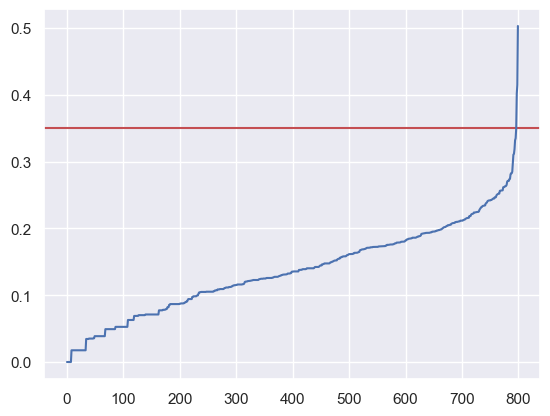

In [60]:
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.axhline(y=0.35, color='r', linestyle='-')
plt.plot(distances)
plt.show()

In [61]:
dbscan = DBSCAN(eps = 0.35, min_samples = 14)
pred = dbscan.fit_predict(train_data_RF5[metric_features])
anom_index = np.where(pred == -1)
train_data_RF5['PatientID']=train_data_RF5.index.copy()
train_data_RF5.reset_index(inplace=True,drop=True)
train_data_RF5.drop(anom_index[0],inplace=True)
train_data_RF5.set_index('PatientID',inplace=True)
scaled_feat=scaler.inverse_transform(train_data_RF5.loc[train_data_RF5.index][metric_features])  
train_data_RF5[metric_features]=scaled_feat
print('Percentage of data kept after removing outliers:', np.round(train_data_RF5.shape[0] / train_data_original.shape[0], 4))

Percentage of data kept after removing outliers: 0.9688


<a class="anchor" id="isol_forest">

### 3.5.6. Isolation Forest

</a>

In [62]:
train_data_RF6=train_data_RF.copy()
model=IsolationForest(contamination=0.03) # expected proportion of outliers to be 3%
model.fit(train_data_RF6.values)
anomaly=model.predict(train_data_RF6.values)
anom_index=np.where(anomaly==-1)
train_data_RF6.reset_index(inplace=True)
train_data_RF6.drop(anom_index[0],inplace=True)
train_data_RF6.set_index('PatientID',inplace=True)
print('Percentage of data kept after removing outliers:', np.round(train_data_RF6.shape[0] / train_data_original.shape[0], 4))

Percentage of data kept after removing outliers: 0.97


<a class="anchor" id="analysis">

## 3.6. Analysis of the dataset after outlier detection and data imputation

</a>

### Data Visualization

#### Histograms

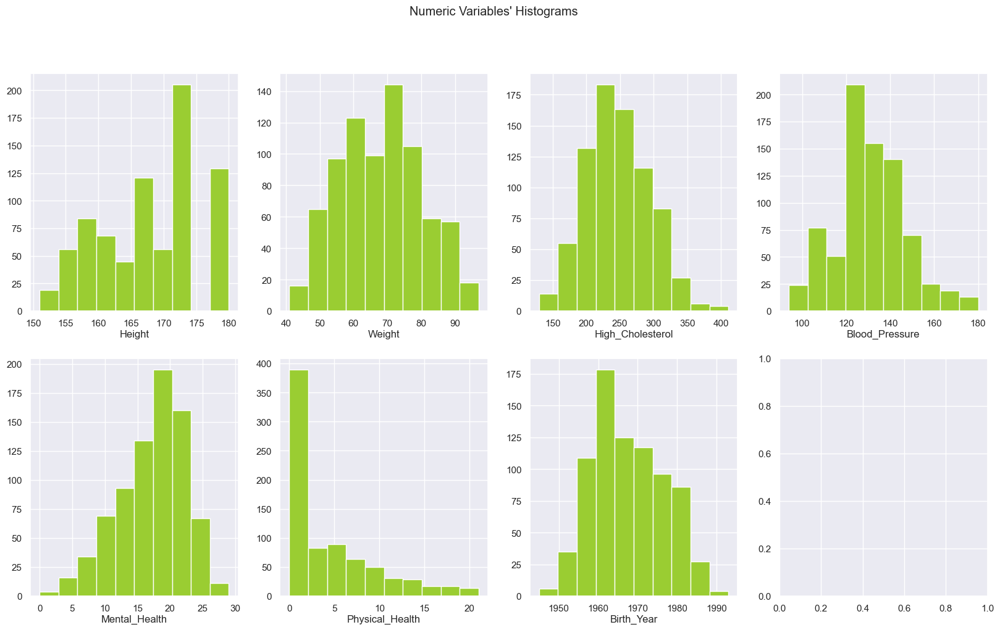

In [63]:
sns.set()
# Preparing figure (creating individual axes where each histogram will be placed)
fig, axes = plt.subplots(2, ceil(len(metric_features) / 2), figsize=(20, 11))
# Plot data (iterating across axes objects and associate each histogram)
for ax, features in zip(axes.flatten(), metric_features):
    ax.hist(train_data_RF2[features], color = 'yellowgreen')
    ax.set_title(features, y=-0.13)
# Layout    
plt.suptitle("Numeric Variables' Histograms")
plt.show()

#### Box Plots

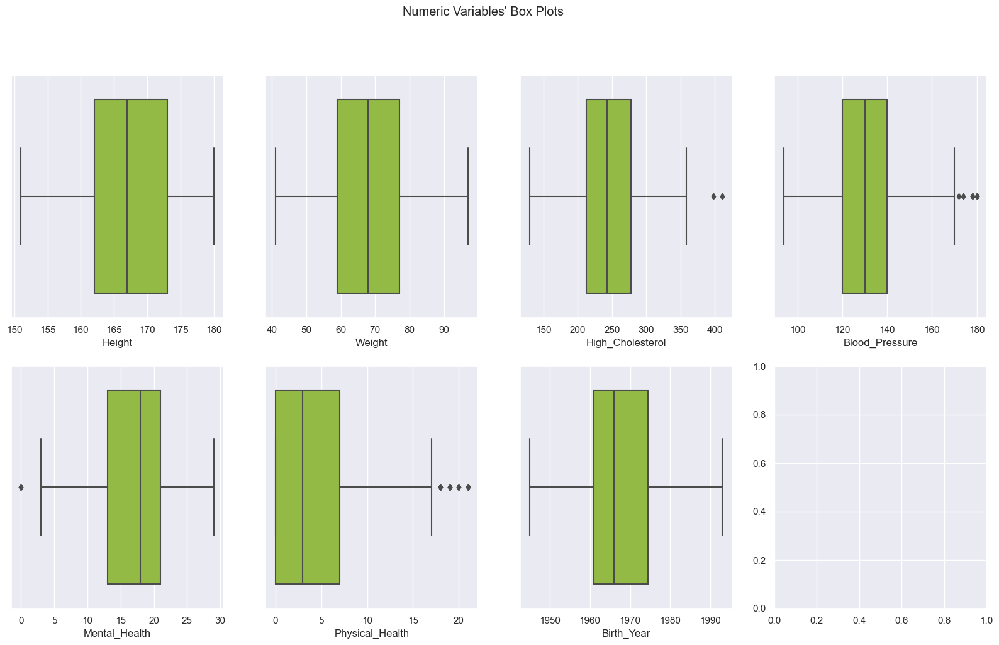

In [64]:
sns.set()
fig, axes = plt.subplots(2, ceil(len(metric_features) / 2), figsize=(20, 11))
for ax, features in zip(axes.flatten(), metric_features):
    sns.boxplot(x = train_data_RF2[features], ax = ax, color = 'yellowgreen')
plt.suptitle("Numeric Variables' Box Plots")
plt.show()

#### Categorical Variables' Absolute Frequencies

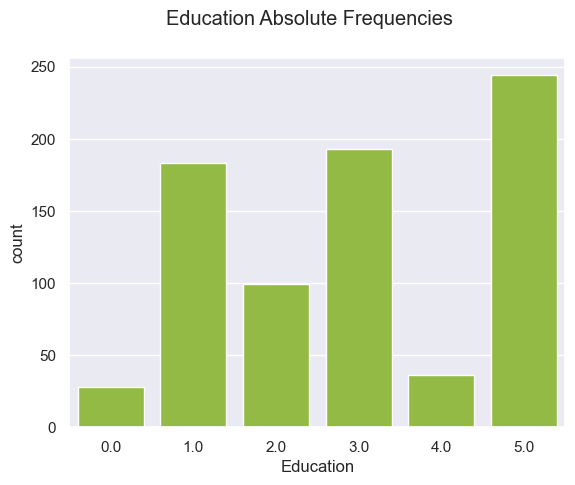

In [65]:
sns.set() 
sns.countplot(x=train_data_RF2["Education"], color='yellowgreen')
plt.suptitle("Education Absolute Frequencies")
plt.show()

### Profile Report

In [66]:
ProfileReport(
    train_data_RF2,
    title='Analysis after outlier detection and data imputation',
    correlations={
        "pearson": {"calculate": True},
        "spearman": {"calculate": True},
        "kendall": {"calculate": False},
        "phi_k": {"calculate": False},
        "cramers": {"calculate": False},
    },                 
)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<hr>
<a class="anchor" id="feat_engineering">
    
# 4. Feature Engineering
    
</a>

#### Train

In [67]:
# Creating new features
train_data_RF2['Gender'] = [1 if bool('Mrs.' in x) == True else 0 for x in train_data_original.loc[train_data_RF2.index]['Name']] 
train_data_RF2['Age'] = datetime.now().year-train_data_RF2['Birth_Year']
train_data_RF2['BMI'] = train_data_RF2['Weight']/((train_data_RF2['Height']/100)**2) # because 'Height' seems to be in cm

In [68]:
# Updating the Metric Features
upd_metric_features = metric_features.copy()
upd_metric_features.append('Age')
upd_metric_features.append('BMI')
# Updating the Non-Metric Features
upd_non_metric_features = non_metric_features.copy()
upd_non_metric_features.append('Gender')

#### Test

In [69]:
# Creating new features
test_data['Gender'] = [1 if bool('Mrs.' in x) == True else 0 for x in test_data_original.loc[test_data.index]['Name']]
test_data['Age'] = datetime.now().year-test_data['Birth_Year']
test_data['BMI'] = test_data['Weight']/((test_data['Height']/100)**2)

<hr>
<a class="anchor" id="feat_selection">
    
# 5. Feature Selection
    
</a>

Removing feature `Birth_Year` because we already have feature `Age`

In [70]:
# Train
train_data_RF2.drop(columns='Birth_Year', inplace=True) 
upd_metric_features.remove('Birth_Year')  # updating the metric features

# Test
test_data.drop(columns='Birth_Year', inplace=True)

#### Defining the independent variables as x and the dependent variable as y

In [71]:
x = train_data_RF2.copy()
y = train_data['Disease'].loc[train_data_RF2.index]

#### Dividing the independent variables into numerical and categorical features

In [72]:
# Train
x_num = x[upd_metric_features]
x_cat = x[upd_non_metric_features]

# Test
test_num = test_data[upd_metric_features]
test_cat = test_data[upd_non_metric_features]

<a class="anchor" id="filter_methods">

## 5.1. Filter Methods

</a>

<a class="anchor" id="spearman">

### 5.1.1. Spearman Correlation

</a>

### Data Scaling

In [73]:
# The Filter Methods we used for numerical variables require these to be scaled
# Train
scaler_num = MinMaxScaler().fit(x_num)
x_num_scaled = scaler_num.transform(x_num) # this will return an array
x_num_scaled = pd.DataFrame(x_num_scaled, columns = x_num.columns).set_index(x.index)  # convert the array to a pandas dataframe

# Test
test_num_scaled = scaler_num.transform(test_num)
test_num_scaled = pd.DataFrame(test_num_scaled, columns = test_num.columns).set_index(test_data.index)

In [74]:
all_train_num = x_num_scaled.join(y) 

In [75]:
def cor_heatmap(cor):
    """ This function plots the correlation between variables """
    plt.figure(figsize=(8,6))
    sns.heatmap(data = cor, annot = True, cmap = plt.cm.Reds, fmt='.1', mask=np.triu(cor))
    plt.show()

cor_spearman = all_train_num.corr(method='spearman')
cor_spearman

,Height,Weight,High_Cholesterol,Blood_Pressure,Mental_Health,Physical_Health,Age,BMI,Disease
Height,1.000000,0.477563,-0.031177,-0.006281,-0.048725,0.070341,-0.054155,-0.027245,-0.156889
Weight,0.477563,1.000000,-0.025235,-0.059803,0.317298,-0.406522,-0.174802,0.847615,0.186656
High_Cholesterol,-0.031177,-0.025235,1.000000,0.135361,-0.035392,0.027989,0.198468,0.015174,-0.113824
Blood_Pressure,-0.006281,-0.059803,0.135361,1.000000,-0.023331,0.119809,0.282531,-0.077338,-0.116541
Mental_Health,-0.048725,0.317298,-0.035392,-0.023331,1.000000,-0.405755,-0.393252,0.382911,0.428723
Physical_Health,0.070341,-0.406522,0.027989,0.119809,-0.405755,1.000000,0.237348,-0.506619,-0.436171
Age,-0.054155,-0.174802,0.198468,0.282531,-0.393252,0.237348,1.000000,-0.155042,-0.239697
BMI,-0.027245,0.847615,0.015174,-0.077338,0.382911,-0.506619,-0.155042,1.000000,0.310080
Disease,-0.156889,0.186656,-0.113824,-0.116541,0.428723,-0.436171,-0.239697,0.310080,1.000000


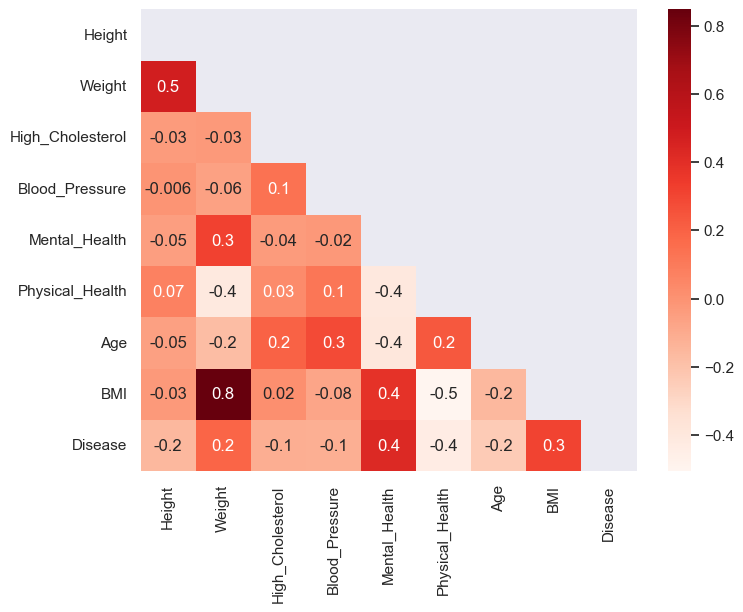

In [76]:
cor_heatmap(cor_spearman)

<a class="anchor" id="variance">

### 5.1.2. Variance of the numerical variables

</a>

In [77]:
x_num_scaled.var()   

Height              0.074597
Weight              0.045934
High_Cholesterol    0.027289
Blood_Pressure      0.035390
Mental_Health       0.034301
Physical_Health     0.060295
Age                 0.035273
BMI                 0.076474
dtype: float64

<a class="anchor" id="anova">

### 5.1.3. ANOVA

</a>

In [78]:
for x_n in x_num_scaled:
    model = ols('y' + '~' + x_n , data=x_num_scaled).fit()
    result_anova = sm.stats.anova_lm(model, typ=2)             # ANOVA Test  
    print(result_anova)

              sum_sq     df          F        PR(>F)
Height      6.181740    1.0  25.504202  5.498317e-07
Residual  189.299741  781.0        NaN           NaN
              sum_sq     df          F    PR(>F)
Weight      5.666281    1.0  23.314074  0.000002
Residual  189.815200  781.0        NaN       NaN
                      sum_sq     df         F    PR(>F)
High_Cholesterol    2.302423    1.0  9.308424  0.002358
Residual          193.179058  781.0       NaN       NaN
                    sum_sq     df          F    PR(>F)
Blood_Pressure    3.847968    1.0  15.682344  0.000082
Residual        191.633514  781.0        NaN       NaN
                   sum_sq     df           F        PR(>F)
Mental_Health   35.283119    1.0  172.012471  1.166793e-35
Residual       160.198362  781.0         NaN           NaN
                     sum_sq     df          F        PR(>F)
Physical_Health   38.573849    1.0  191.99943  3.372237e-39
Residual         156.907633  781.0        NaN           NaN
    

<a class="anchor" id="kendalls">

### 5.1.4. Kendall's

</a>

In [79]:
# Checking the correlation between the numerical variables and the target
cor_kendall = all_train_num.corr(method='kendall')['Disease']   
cor_kendall

Height             -0.132964
Weight              0.154190
High_Cholesterol   -0.093367
Blood_Pressure     -0.098003
Mental_Health       0.360029
Physical_Health    -0.381101
Age                -0.199039
BMI                 0.253614
Disease             1.000000
Name: Disease, dtype: float64

<a class="anchor" id="value_counts">

### 5.1.5. Value Counts for each Categorical Variable

</a>

#### Reverse OneHotEncoding for categorical features

In [80]:
x_cat_ohc = x_cat.drop(['Drinking_Habit', 'Fruit_Habit', 'Water_Habit', 'Education', 'Gender'], axis = 1)
ohc_df_reverse = pd.DataFrame(data = oenc.inverse_transform(x_cat_ohc), columns=onehot_features, index = x_cat_ohc.index)
ohc_df_reverse

,Smoking_Habit,Exercise,Region,Checkup,Diabetes
PatientID,,,,,
1167,No,Yes,London,More than 3 years,"I don't have diabetes, but I have direct famil..."
1805,No,Yes,South West,Not sure,"I don't have diabetes, but I have direct famil..."
1557,No,No,Yorkshire and the Humber,More than 3 years,"I don't have diabetes, but I have direct famil..."
1658,No,Yes,London,Not sure,Neither I nor my immediate family have diabetes.
1544,No,No,South East,More than 3 years,Neither I nor my immediate family have diabetes.
...,...,...,...,...,...
1909,No,Yes,East Midlands,Not sure,"I don't have diabetes, but I have direct famil..."
1386,No,No,North West,More than 3 years,Neither I nor my immediate family have diabetes.
1088,No,No,East Midlands,More than 3 years,"I don't have diabetes, but I have direct famil..."


In [81]:
x_cat_no_ohc = x_cat.drop(['Smoking_Habit', 'Exercise', 'Region_EastOfEngland', 'Region_London', 'Region_NorthEast',
                           'Region_NorthWest', 'Region_SouthEast', 'Region_SouthWest', 'Region_WestMidlands',
                           'Region_YorkshireAndTheHumber', 'Checkup_LessThan3Months', 'Checkup_MoreThan3Years',
                           'Checkup_NotSure', 'Diabetes_A', 'Diabetes_B', 'Diabetes_C'], axis=1)
x_cat_no_ohc

,Drinking_Habit,Fruit_Habit,Water_Habit,Education,Gender
PatientID,,,,,
1167,2.0,0.0,2.0,2.0,1
1805,1.0,0.0,2.0,2.0,0
1557,1.0,0.0,1.0,1.0,0
1658,2.0,0.0,1.0,5.0,0
1544,1.0,1.0,1.0,4.0,0
...,...,...,...,...,...
1909,1.0,0.0,2.0,2.0,0
1386,2.0,0.0,2.0,1.0,1
1088,1.0,2.0,1.0,1.0,1


In [82]:
x_cat = pd.concat([x_cat_no_ohc, ohc_df_reverse], axis = 1)
x_cat.head()

,Drinking_Habit,Fruit_Habit,Water_Habit,Education,Gender,Smoking_Habit,Exercise,Region,Checkup,Diabetes
PatientID,,,,,,,,,,
1167,2.0,0.0,2.0,2.0,1,No,Yes,London,More than 3 years,"I don't have diabetes, but I have direct famil..."
1805,1.0,0.0,2.0,2.0,0,No,Yes,South West,Not sure,"I don't have diabetes, but I have direct famil..."
1557,1.0,0.0,1.0,1.0,0,No,No,Yorkshire and the Humber,More than 3 years,"I don't have diabetes, but I have direct famil..."
1658,2.0,0.0,1.0,5.0,0,No,Yes,London,Not sure,Neither I nor my immediate family have diabetes.
1544,1.0,1.0,1.0,4.0,0,No,No,South East,More than 3 years,Neither I nor my immediate family have diabetes.


In [83]:
for var in x_cat.columns:
    print(x_cat[var].value_counts())   

2.0    403
1.0    369
0.0     11
Name: Drinking_Habit, dtype: int64
0.0    446
1.0    170
2.0    100
3.0     55
4.0     12
Name: Fruit_Habit, dtype: int64
2.0    356
1.0    345
0.0     82
Name: Water_Habit, dtype: int64
5.0    244
3.0    193
1.0    183
2.0     99
4.0     36
0.0     28
Name: Education, dtype: int64
0    558
1    225
Name: Gender, dtype: int64
No     661
Yes    122
Name: Smoking_Habit, dtype: int64
No     527
Yes    256
Name: Exercise, dtype: int64
East Midlands               150
London                      135
South West                  105
West Midlands                87
South East                   84
East of England              80
Yorkshire and the Humber     64
North West                   57
North East                   21
Name: Region, dtype: int64
More than 3 years                         427
Not sure                                  297
Less than 3 years but more than 1 year     53
Less than three months                      6
Name: Checkup, dtype: int64
I don

<a class="anchor" id="chi_squared">

### 5.1.6. Chi-Squared

</a>

In [84]:
def TestIndependence(X,y,var,alpha=0.05):
    """ This function follows the steps of Chi-Square to check if an independent variable is an important predictor.
    Parameters:
    X: dataset with the independent variables
    y: target
    var: name of each independent variable
    alpha: the defined alpha. Defaults to 0.05
    """
    dfObserved = pd.crosstab(y,X)  
                                      
    chi2, p, dof, expected = stats.chi2_contingency(dfObserved.values)   
                                                                         
    dfExpected = pd.DataFrame(expected, columns=dfObserved.columns, index = dfObserved.index)
    if p<alpha:    
        result="{0} is IMPORTANT for Prediction".format(var)
    else:
        result="{0} is NOT an important predictor. (Discard {0} from model)".format(var)
    print(result)

In [85]:
for var in x_cat:
    TestIndependence(x_cat[var],y, var)

Drinking_Habit is IMPORTANT for Prediction
Fruit_Habit is IMPORTANT for Prediction
Water_Habit is NOT an important predictor. (Discard Water_Habit from model)
Education is NOT an important predictor. (Discard Education from model)
Gender is IMPORTANT for Prediction
Smoking_Habit is NOT an important predictor. (Discard Smoking_Habit from model)
Exercise is IMPORTANT for Prediction
Region is NOT an important predictor. (Discard Region from model)
Checkup is IMPORTANT for Prediction
Diabetes is IMPORTANT for Prediction


<a class="anchor" id="wrapper_methods">

## 5.2. Wrapper Methods

</a>

<a class="anchor" id="RFECV_log">

### 5.2.1. Recursive Feature Elimination with Cross Validation (RFECV) using Logistic Regression

</a>

In [86]:
model = LogisticRegression(max_iter=1500, random_state = 10)

In [87]:
rfecv = RFECV(estimator = model, cv=10)
x_rfecv = rfecv.fit_transform(X=x_num_scaled, y=y)

# Variables that were selected by RFECV as the most "important" ones
selected_features_rfecv = pd.Series(rfecv.support_, index = x_num_scaled.columns)
selected_features_rfecv

Height               True
Weight              False
High_Cholesterol     True
Blood_Pressure      False
Mental_Health        True
Physical_Health      True
Age                 False
BMI                 False
dtype: bool

In [88]:
# Ranking of the variables defined by RFECV
pd.Series(rfecv.ranking_, index = x_num_scaled.columns)

Height              1
Weight              5
High_Cholesterol    1
Blood_Pressure      2
Mental_Health       1
Physical_Health     1
Age                 4
BMI                 3
dtype: int32

<a class="anchor" id="RFECV_RF">

### 5.2.2. Recursive Feature Elimination with Cross Validation (RFECV) using Random Forest

</a>

In [89]:
model = RandomForestClassifier(random_state = 10)

In [90]:
rfecv = RFECV(estimator = model, cv=10)
x_rfecv = rfecv.fit_transform(X=x_num_scaled, y=y)

# Variables that were selected by RFECV as the most "important" ones
selected_features_rfecv = pd.Series(rfecv.support_, index = x_num_scaled.columns)
selected_features_rfecv

Height              False
Weight              False
High_Cholesterol     True
Blood_Pressure      False
Mental_Health        True
Physical_Health      True
Age                  True
BMI                 False
dtype: bool

In [91]:
# Ranking of the variables defined by RFECV
pd.Series(rfecv.ranking_, index = x_num_scaled.columns)

Height              4
Weight              5
High_Cholesterol    1
Blood_Pressure      3
Mental_Health       1
Physical_Health     1
Age                 1
BMI                 2
dtype: int32

<a class="anchor" id="embedded_methods">

## 5.3. Embedded Methods

</a>

<a class="anchor" id="lasso">

### 5.3.1. Lasso Regression with Cross Validation

</a>

In [92]:
def plot_importance(coef,name):
    """ This function plots the importance of the features """
    imp_coef = coef.sort_values()
    plt.figure(figsize=(8,10))
    imp_coef.plot(kind = "barh")
    plt.title("Feature importance using " + name + " Model")
    plt.show()

In [93]:
lasso_cv = LassoCV(cv=10,random_state = 10).fit(x_num_scaled, y)
coef_num_feat_lasso = pd.Series(lasso_cv.coef_ ,index=x_num_scaled.columns)
coef_num_feat_lasso

Height             -0.257641
Weight             -0.000000
High_Cholesterol   -0.241482
Blood_Pressure     -0.176318
Mental_Health       0.785750
Physical_Health    -0.607395
Age                -0.033081
BMI                 0.087701
dtype: float64

In [94]:
print("Lasso picked " + str(sum(coef_num_feat_lasso != 0)) + " variables and eliminated the other " +  str(sum(coef_num_feat_lasso == 0)) + " variables")

Lasso picked 7 variables and eliminated the other 1 variables


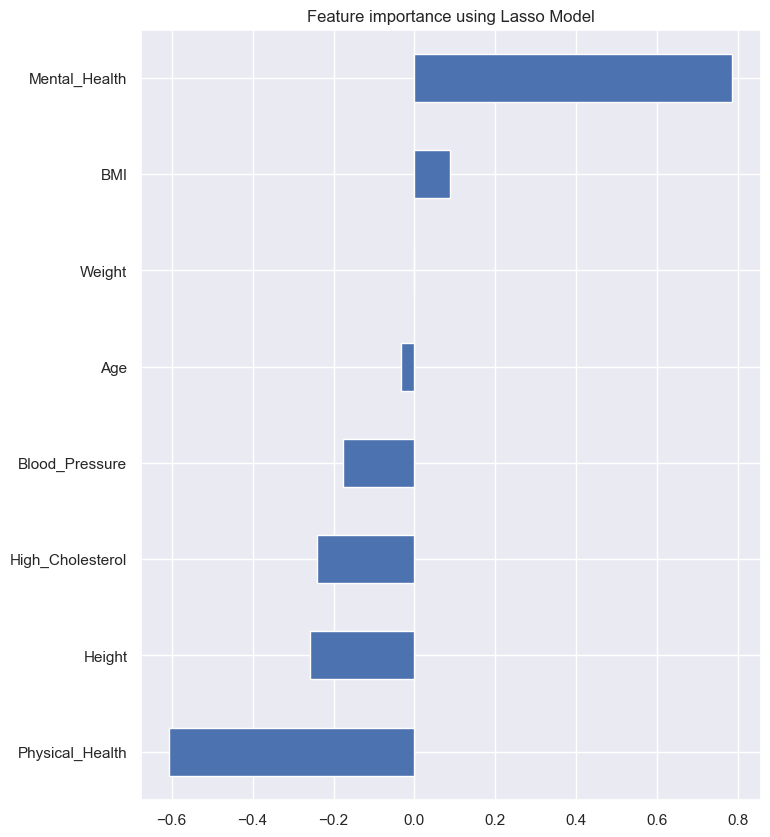

In [95]:
plot_importance(coef_num_feat_lasso,'Lasso')

<a class="anchor" id="ridge">

### 5.3.2. Ridge Regression with Cross Validation

</a>

In [96]:
ridge_cv = RidgeCV(cv=10).fit(X = x_num_scaled, y = y)
coef_num_feat_ridge = pd.Series(ridge_cv.coef_, index = x_num_scaled.columns)
coef_num_feat_ridge

Height             -0.209741
Weight             -0.125357
High_Cholesterol   -0.245350
Blood_Pressure     -0.176623
Mental_Health       0.759962
Physical_Health    -0.600139
Age                -0.053480
BMI                 0.180894
dtype: float64

In [97]:
print("Ridge picked " + str(sum(coef_num_feat_ridge != 0)) + " variables and eliminated the other " +  str(sum(coef_num_feat_ridge == 0)) + " variables")

Ridge picked 8 variables and eliminated the other 0 variables


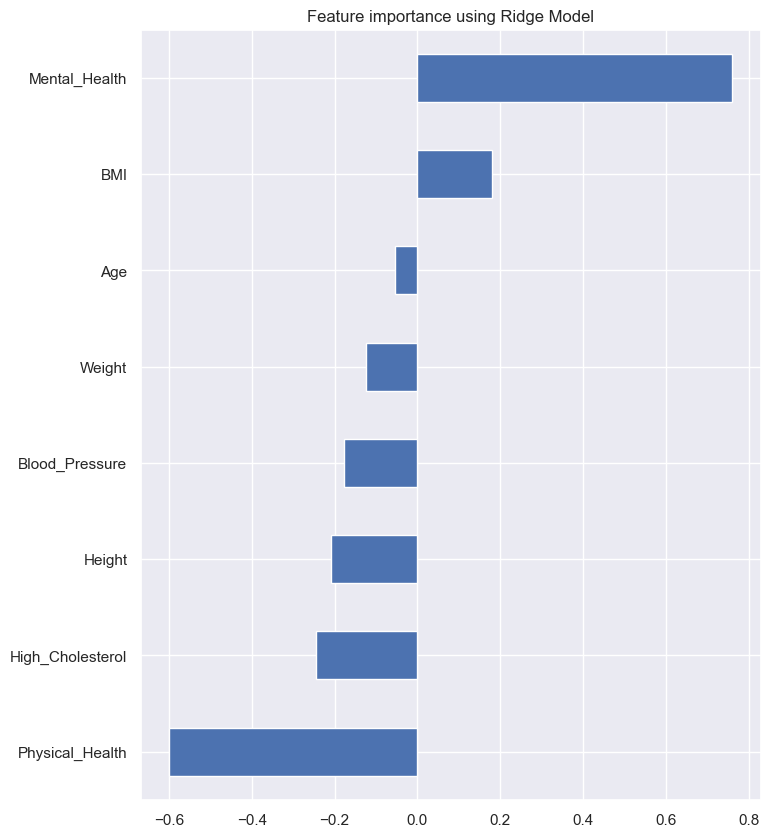

In [98]:
plot_importance(coef_num_feat_ridge,'Ridge') 

<a class="anchor" id="gini/entropy">

### 5.3.3. Gini Importance and Entropy Importance

</a>

In [99]:
def dtcv_importance(crit):
    skf = StratifiedKFold(n_splits=10)
    model=DecisionTreeClassifier(criterion=crit,random_state=10)
    crit_importance=[]
    for train_index, test_index in skf.split(x_num,y):
        x_train, X_test = x_num.iloc[train_index], x_num.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]
        crit_importance.append(model.fit(x_train, y_train).feature_importances_)
    return np.mean(crit_importance,axis=0)

In [100]:
gini_importance = dtcv_importance('gini')
entropy_importance = dtcv_importance('entropy')

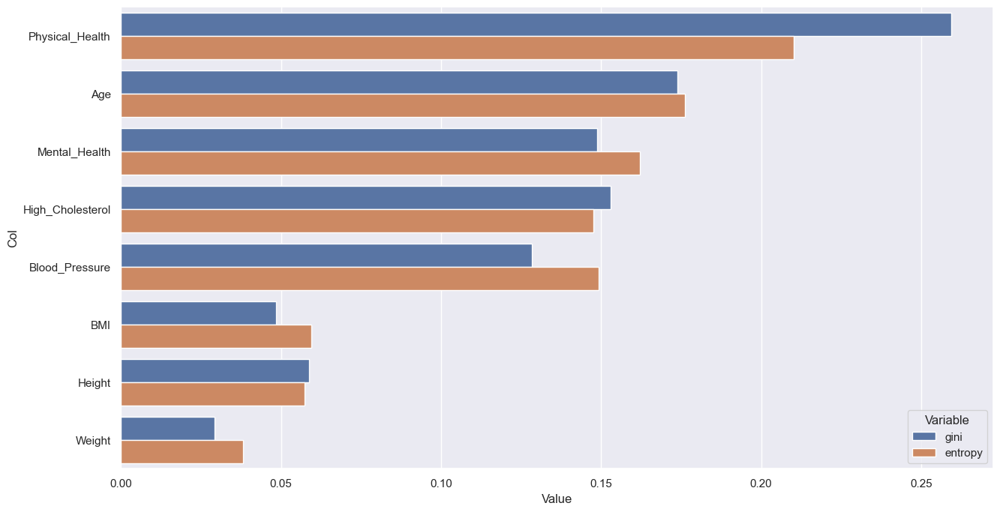

In [101]:
zippy = pd.DataFrame(zip(gini_importance, entropy_importance), columns = ['gini','entropy'])
zippy['col'] = x_num.columns
tidy = zippy.melt(id_vars='col').rename(columns=str.title)
tidy.sort_values(['Value'], ascending = False, inplace = True)

plt.figure(figsize=(15,8))
sns.barplot(y='Col', x='Value', hue='Variable', data=tidy)
plt.show()

<a class="anchor" id="conclusions">

## 5.4. Conclusions

</a>

<hr>

### Numerical Data

| Predictor | Spearman | Variance | ANOVA | RFE (Logistic Regression) | RFE (Random Forest) | Lasso | Ridge | Kendall's | Gini | Entropy | What to do? (One possible way to "solve") | 
| --- | --- | --- | --- |--- | --- | --- | --- | --- | --- | --- | --- |
| Height | Keep | Keep | Keep | Keep | Discard | Keep | Keep | Keep | Keep? | Keep? | Try with and without
| Weight | Discard | Keep | Keep | Discard | Discard | Discard | Keep | Keep | Keep? | Keep? | Discard
| High_Cholesterol | Keep | Keep | Keep | Keep | Keep | Keep | Keep | Keep? | Keep | Keep | Keep
| Blood_Pressure | Keep | Keep | Keep | Discard | Keep | Keep | Keep | Keep? | Keep | Keep | Keep
| Mental_Health | Keep? | Keep | Keep | Keep | Keep | Keep | Keep | Keep | Keep | Keep | Keep
| Physical_Health | Keep? | Keep | Keep | Keep | Keep | Keep | Keep | Keep | Keep | Keep | Keep
| Age | Keep | Keep | Keep |  Discard | Keep | Keep? | Keep? | Keep | Keep | Keep | Try with and without
| BMI | Keep? | Keep | Keep |  Discard | Keep | Keep? | Keep | Keep | Keep? | Keep? | Try with and without

<hr>


### Categorical Data

| Predictor | Value Counts | Chi-Square | What to do? (One possible way to "solve") | 
| --- | --- | --- | --- |
| Drinking_Habit | Keep | Keep | Keep
| Fruit_Habit | Keep | Keep | Keep
| Water_Habit | Keep | Discard | Discard
| Education | Keep | Discard | Discard
| Smoking_Habit | Keep | Discard | Discard
| Exercise | Keep | Keep | Keep
| Region | Keep | Discard | Discard
| Checkup | Keep | Keep | Keep
| Diabetes | Keep | Keep | Keep
| Gender | Keep | Keep | Keep

<hr>

<hr>
<a class="anchor" id="modelling">
    
# 6. Modelling
    
</a>

### Defining different sets of features

In [102]:
# All the features 
feat_all= ['Height', 'High_Cholesterol','Blood_Pressure','Mental_Health','Physical_Health','Age','BMI','Drinking_Habit',
       'Fruit_Habit','Exercise','Checkup_LessThan3Months','Checkup_MoreThan3Years','Checkup_NotSure',
       'Diabetes_A','Diabetes_B','Diabetes_C','Gender']

# Without 'Height'
feat1 = ['High_Cholesterol','Blood_Pressure','Mental_Health','Physical_Health','Age','BMI','Drinking_Habit',
       'Fruit_Habit','Exercise','Checkup_LessThan3Months','Checkup_MoreThan3Years','Checkup_NotSure',
       'Diabetes_A','Diabetes_B','Diabetes_C','Gender']

# Without 'Age'
feat2 = ['Height', 'High_Cholesterol','Blood_Pressure','Mental_Health','Physical_Health','BMI','Drinking_Habit',
       'Fruit_Habit','Exercise','Checkup_LessThan3Months','Checkup_MoreThan3Years','Checkup_NotSure',
       'Diabetes_A','Diabetes_B','Diabetes_C','Gender']

# Without 'BMI'
feat3 = ['Height', 'High_Cholesterol','Blood_Pressure','Mental_Health','Physical_Health','Age', 'Drinking_Habit',
       'Fruit_Habit','Exercise','Checkup_LessThan3Months','Checkup_MoreThan3Years','Checkup_NotSure',
       'Diabetes_A','Diabetes_B','Diabetes_C','Gender']


# Without 'Height' and 'Age'
feat4 = ['High_Cholesterol','Blood_Pressure','Mental_Health','Physical_Health', 'BMI','Drinking_Habit',
       'Fruit_Habit','Exercise','Checkup_LessThan3Months','Checkup_MoreThan3Years','Checkup_NotSure',
       'Diabetes_A','Diabetes_B','Diabetes_C','Gender']

# Without 'Height' and 'BMI'
feat5 = ['High_Cholesterol','Blood_Pressure','Mental_Health','Physical_Health','Age','Drinking_Habit',
       'Fruit_Habit','Exercise','Checkup_LessThan3Months','Checkup_MoreThan3Years','Checkup_NotSure',
       'Diabetes_A','Diabetes_B','Diabetes_C','Gender']

# Without 'Age' and 'BMI'
feat6 = ['Height', 'High_Cholesterol','Blood_Pressure','Mental_Health','Physical_Health','Drinking_Habit',
       'Fruit_Habit','Exercise','Checkup_LessThan3Months','Checkup_MoreThan3Years','Checkup_NotSure',
       'Diabetes_A','Diabetes_B','Diabetes_C','Gender']

# Without 'Height', 'Age' and 'BMI'
feat7 = ['High_Cholesterol','Blood_Pressure','Mental_Health','Physical_Health','Drinking_Habit',
       'Fruit_Habit','Exercise','Checkup_LessThan3Months','Checkup_MoreThan3Years','Checkup_NotSure',
       'Diabetes_A','Diabetes_B','Diabetes_C','Gender']

### Score function

In [103]:
cv=StratifiedKFold(10)
def avg_score(model, x,y):
    scores=cross_validate(model,x,y,scoring='f1',cv=cv,return_train_score=True)
    return np.mean(scores['train_score']), np.mean(scores['test_score'])

In [104]:
# This function helps us identify the parameters to use in GridSearch  #example of what we used in the modelling
def get_models(values,x,y):
    models = dict()
    for value in values:
        models[str(value)] = avg_score(LogisticRegression(C = value, random_state = 10,max_iter=5000),x,y)   
    return models

### Function to find best combination of features and feature scaling

In [105]:
# In order to test all combinations of features
feat = [['Height', 'High_Cholesterol','Blood_Pressure','Mental_Health','Physical_Health','Age','BMI','Drinking_Habit',
         'Fruit_Habit','Exercise','Checkup_LessThan3Months','Checkup_MoreThan3Years','Checkup_NotSure','Diabetes_A',
         'Diabetes_B','Diabetes_C','Gender'],
        ['High_Cholesterol','Blood_Pressure','Mental_Health','Physical_Health','Age','BMI','Drinking_Habit','Fruit_Habit',
         'Exercise','Checkup_LessThan3Months','Checkup_MoreThan3Years','Checkup_NotSure','Diabetes_A','Diabetes_B',
         'Diabetes_C','Gender'],
        ['Height', 'High_Cholesterol','Blood_Pressure','Mental_Health','Physical_Health','BMI','Drinking_Habit','Fruit_Habit',
         'Exercise','Checkup_LessThan3Months','Checkup_MoreThan3Years','Checkup_NotSure','Diabetes_A','Diabetes_B',
         'Diabetes_C','Gender'],
        ['Height', 'High_Cholesterol','Blood_Pressure','Mental_Health','Physical_Health','Age', 'Drinking_Habit','Fruit_Habit',
         'Exercise','Checkup_LessThan3Months','Checkup_MoreThan3Years','Checkup_NotSure','Diabetes_A','Diabetes_B',
         'Diabetes_C','Gender'],
        ['High_Cholesterol','Blood_Pressure','Mental_Health','Physical_Health', 'BMI','Drinking_Habit','Fruit_Habit',
         'Exercise','Checkup_LessThan3Months','Checkup_MoreThan3Years','Checkup_NotSure','Diabetes_A','Diabetes_B',
         'Diabetes_C','Gender'],
        ['High_Cholesterol','Blood_Pressure','Mental_Health','Physical_Health','Age','Drinking_Habit','Fruit_Habit',
         'Exercise','Checkup_LessThan3Months','Checkup_MoreThan3Years','Checkup_NotSure','Diabetes_A','Diabetes_B',
         'Diabetes_C','Gender'],
        ['Height', 'High_Cholesterol','Blood_Pressure','Mental_Health','Physical_Health','Drinking_Habit','Fruit_Habit',
         'Exercise','Checkup_LessThan3Months','Checkup_MoreThan3Years','Checkup_NotSure','Diabetes_A','Diabetes_B',
         'Diabetes_C','Gender'],
        ['High_Cholesterol','Blood_Pressure','Mental_Health','Physical_Health','Drinking_Habit','Fruit_Habit','Exercise',
         'Checkup_LessThan3Months','Checkup_MoreThan3Years','Checkup_NotSure','Diabetes_A','Diabetes_B','Diabetes_C','Gender']]

In [106]:
min_max = MinMaxScaler()
standard = StandardScaler()
robust = RobustScaler()
x_minmax=x.copy()
scaled_minmax = min_max.fit_transform(x_minmax)
x_minmax = pd.DataFrame(data = scaled_minmax, columns = x.columns, index = x.index)
x_standard=x.copy()
scaled_standard = standard.fit_transform(x_standard)
x_standard = pd.DataFrame(data = scaled_standard, columns = x.columns, index = x.index)
x_robust=x.copy()
scaled_robust = robust.fit_transform(x_robust)
x_robust = pd.DataFrame(data = scaled_robust, columns = x.columns, index = x.index)

In [107]:
test_minmax=test_data.copy()
scaled_minmax=min_max.fit_transform(test_minmax)
test_minmax = pd.DataFrame(data = scaled_minmax, columns = test_data.columns, index = test_data.index)
test_standard=test_data.copy()
scaled_standard = standard.fit_transform(test_standard)
test_standard = pd.DataFrame(data = scaled_standard, columns = test_data.columns, index = test_data.index)
test_robust=test_data.copy()
scaled_robust = robust.fit_transform(test_robust)
test_robust = pd.DataFrame(data = scaled_robust, columns = test_data.columns, index = test_data.index)

In [108]:
def best_feat(model,scaling):
    if scaling=='not_scaled':   
        not_scaled=[]
        for value in feat:
            not_scaled.append(list(avg_score(model, x.loc[:,value], y)))
        df_not_scaled = pd.DataFrame(not_scaled, columns=['Train Score not scaled', 'Val Score not scaled'])
        index = ['All','Without Height','Without Age','Without BMI','Without Age and Height','Without BMI and Height',
                     'Without Age and BMI','Without Age, Height and BMI']
        df_not_scaled.index = index
        return df_not_scaled
    if scaling=='scaled':
        minmax_score=[]
        standard_score=[]
        robust_score=[]
        for value in feat:
            minmax_score.append(list(avg_score(model, x_minmax.loc[:,value], y)))
            standard_score.append(list(avg_score(model, x_standard.loc[:,value], y)))
            robust_score.append(list(avg_score(model, x_robust.loc[:,value], y)))
        df_minmax = pd.DataFrame(minmax_score, columns=['Train Score MinMax', 'Val Score MinMax'])
        df_standard = pd.DataFrame(standard_score, columns=['Train Score Standard', 'Val Score Standard'])
        df_robust = pd.DataFrame(robust_score, columns=['Train Score Robust', 'Val Score Robust'])
        index = ['All','Without Height','Without Age','Without BMI','Without Age and Height','Without BMI and Height',
                     'Without Age and BMI','Without Age, Height and BMI']
        df_minmax.index = index
        df_standard.index = index
        df_robust.index = index
        return pd.concat([df_minmax, df_standard, df_robust], axis = 1)
    if scaling!='scaled' and scaling!='not_scaled':
        raise ValueError('Scaling only accepts "scaled" and "not_scaled"')

<a class="anchor" id="log_reg">

## 6.1. Logistic Regression

</a>

Data needs to be scaled when used with regularization.

In [109]:
# GridSearchCV
param_grid_log = {'penalty': ['l1','l2','elasticnet','none'],
                  'C' : [0.001, 0.01, 0.1, 1],
                  'solver' : ['lbfgs','sag']
}
grid_log = GridSearchCV(estimator=LogisticRegression(max_iter=5000, random_state=10), param_grid=param_grid_log, scoring='f1', cv=10, return_train_score=True)
grid_log.fit(x_minmax.loc[:, feat_all], y)

GridSearchCV(cv=10,
             estimator=LogisticRegression(max_iter=5000, random_state=10),
             param_grid={'C': [0.001, 0.01, 0.1, 1],
                         'penalty': ['l1', 'l2', 'elasticnet', 'none'],
                         'solver': ['lbfgs', 'sag']},
             return_train_score=True, scoring='f1')

In [110]:
# Best parameter set
print('------------------------------------------------------------------------------------------------------------------------')
print('Best parameters found:\n', grid_log.best_params_)
print('------------------------------------------------------------------------------------------------------------------------')

# All results
means = grid_log.cv_results_['mean_test_score']
stds = grid_log.cv_results_['std_test_score']
mean_trains = grid_log.cv_results_['mean_train_score']
params = grid_log.cv_results_['params']
overfitting = (mean_trains - means)

results = pd.DataFrame(zip(means, stds, mean_trains, params, overfitting), columns=['Mean Val','Std','Mean Train','Params','Overfitting'])
results.sort_values(by=['Mean Val'], inplace = True, ascending = False)
results.head(15)

------------------------------------------------------------------------------------------------------------------------
Best parameters found:
 {'C': 0.001, 'penalty': 'none', 'solver': 'lbfgs'}
------------------------------------------------------------------------------------------------------------------------


,Mean Val,Std,Mean Train,Params,Overfitting
6,0.859733,0.038489,0.867890,"{'C': 0.001, 'penalty': 'none', 'solver': 'lbf...",0.008157
7,0.859733,0.038489,0.868041,"{'C': 0.001, 'penalty': 'none', 'solver': 'sag'}",0.008307
14,0.859733,0.038489,0.867890,"{'C': 0.01, 'penalty': 'none', 'solver': 'lbfgs'}",0.008157
15,0.859733,0.038489,0.868041,"{'C': 0.01, 'penalty': 'none', 'solver': 'sag'}",0.008307
22,0.859733,0.038489,0.867890,"{'C': 0.1, 'penalty': 'none', 'solver': 'lbfgs'}",0.008157
23,0.859733,0.038489,0.868041,"{'C': 0.1, 'penalty': 'none', 'solver': 'sag'}",0.008307
30,0.859733,0.038489,0.867890,"{'C': 1, 'penalty': 'none', 'solver': 'lbfgs'}",0.008157
31,0.859733,0.038489,0.868041,"{'C': 1, 'penalty': 'none', 'solver': 'sag'}",0.008307
26,0.852916,0.039116,0.863839,"{'C': 1, 'penalty': 'l2', 'solver': 'lbfgs'}",0.010923
27,0.852916,0.039116,0.863839,"{'C': 1, 'penalty': 'l2', 'solver': 'sag'}",0.010923


In [111]:
print('Best parameters: ', results.loc[18]['Params'],
     '\nTrain:', str(results.loc[18]['Mean Train']), '\nVal: ', str(results.loc[18]['Mean Val']))

Best parameters:  {'C': 0.1, 'penalty': 'l2', 'solver': 'lbfgs'} 
Train: 0.8476962030719104 
Val:  0.8459124296454046


### Testing different combinations of features

In [112]:
log_model = LogisticRegression(C = 0.1, penalty = 'l2', solver = 'lbfgs', max_iter=5000,random_state=10)

In [113]:
best_feat(log_model,"scaled")

,Train Score MinMax,Val Score MinMax,Train Score Standard,Val Score Standard,Train Score Robust,Val Score Robust
All,0.847696,0.845912,0.867781,0.861242,0.871436,0.863646
Without Height,0.847739,0.843473,0.865557,0.857779,0.871403,0.861317
Without Age,0.850089,0.843919,0.870937,0.864945,0.873080,0.865780
Without BMI,0.845304,0.842628,0.868767,0.855264,0.866598,0.860974
Without Age and Height,0.849482,0.843847,0.868555,0.861670,0.874246,0.866893
Without BMI and Height,0.845641,0.843524,0.863910,0.851820,0.866220,0.858611
Without Age and BMI,0.843793,0.837710,0.871086,0.862968,0.869849,0.863307
"Without Age, Height and BMI",0.843416,0.840095,0.870539,0.856766,0.870523,0.861952


In [114]:
f1_lr = avg_score(log_model, x_robust.loc[:,feat3],y)[1]

### Testing Kaggle

In [115]:
avg_score(log_model, x_robust.loc[:,feat3],y)

(0.8665977499238215, 0.8609741683690155)

In [116]:
log_model = log_model.fit(x_robust.loc[:,feat3],y)
y_pred_log = log_model.predict(test_robust.loc[:,feat3])
y_pred_log

array([1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1,
       0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1,
       0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1,
       0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0,
       0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0,
       1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1,
       0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0,
       1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1,
       1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1,
       0, 1, 0, 1, 0], dtype=int64)

In [117]:
kaggle_log = pd.DataFrame(y_pred_log, columns=['Disease'], index=test_data.index)
kaggle_log.to_csv('Group33.csv')
# score: 0.8188

<a class="anchor" id="log_reg_pol">

## 6.2. Logistic Regression using Polynomial Features

</a>

Data needs to be scaled when used with regularization.

In [118]:
pol = PolynomialFeatures()
data_pol = pd.DataFrame(data=pol.fit_transform(x_minmax.loc[:, feat_all]))  # dataframe with the new polynomial features

In [119]:
# GridSearchCV
param_grid_pol = {'penalty': ['l1','l2','elasticnet','none'],
                  'C' : [0.001, 0.01, 0.1, 1],
                  'solver' : ['sag','saga']
}
grid_pol = GridSearchCV(estimator=LogisticRegression(max_iter=10000, random_state=10), param_grid=param_grid_pol, scoring='f1', cv=10, return_train_score=True)
grid_pol.fit(data_pol, y)

GridSearchCV(cv=10,
             estimator=LogisticRegression(max_iter=10000, random_state=10),
             param_grid={'C': [0.001, 0.01, 0.1, 1],
                         'penalty': ['l1', 'l2', 'elasticnet', 'none'],
                         'solver': ['sag', 'saga']},
             return_train_score=True, scoring='f1')

In [120]:
# Best parameter set
print('------------------------------------------------------------------------------------------------------------------------')
print('Best parameters found:\n', grid_pol.best_params_)
print('------------------------------------------------------------------------------------------------------------------------')

# All results
means = grid_pol.cv_results_['mean_test_score']
stds = grid_pol.cv_results_['std_test_score']
mean_trains = grid_pol.cv_results_['mean_train_score']
params = grid_pol.cv_results_['params']
overfitting = (mean_trains - means)

results = pd.DataFrame(zip(means, stds, mean_trains, params, overfitting), columns=['Mean Val','Std','Mean Train','Params','Overfitting'])
results.sort_values(by=['Overfitting'], inplace = True, ascending = True)
results.head(25)

------------------------------------------------------------------------------------------------------------------------
Best parameters found:
 {'C': 0.001, 'penalty': 'none', 'solver': 'sag'}
------------------------------------------------------------------------------------------------------------------------


,Mean Val,Std,Mean Train,Params,Overfitting
1,0.682909,0.004608,0.682927,"{'C': 0.001, 'penalty': 'l1', 'solver': 'saga'}",0.000017
9,0.682909,0.004608,0.682927,"{'C': 0.01, 'penalty': 'l1', 'solver': 'saga'}",0.000017
2,0.831498,0.041254,0.832808,"{'C': 0.001, 'penalty': 'l2', 'solver': 'sag'}",0.001310
3,0.831498,0.041254,0.832808,"{'C': 0.001, 'penalty': 'l2', 'solver': 'saga'}",0.001310
10,0.841080,0.044003,0.845867,"{'C': 0.01, 'penalty': 'l2', 'solver': 'sag'}",0.004787
11,0.841080,0.044003,0.846092,"{'C': 0.01, 'penalty': 'l2', 'solver': 'saga'}",0.005012
17,0.855731,0.040079,0.863669,"{'C': 0.1, 'penalty': 'l1', 'solver': 'saga'}",0.007937
18,0.858941,0.043601,0.868982,"{'C': 0.1, 'penalty': 'l2', 'solver': 'sag'}",0.010041
19,0.858941,0.043601,0.868982,"{'C': 0.1, 'penalty': 'l2', 'solver': 'saga'}",0.010041
25,0.873984,0.041065,0.898628,"{'C': 1, 'penalty': 'l1', 'solver': 'saga'}",0.024644


In [121]:
print('Best parameters: ', results.loc[2]['Params'],
     '\nTrain:', str(results.loc[2]['Mean Train']), '\nVal: ', str(results.loc[2]['Mean Val']))

Best parameters:  {'C': 0.001, 'penalty': 'l2', 'solver': 'sag'} 
Train: 0.8328077003710979 
Val:  0.8314976689124658


In [122]:
pol_model = LogisticRegression(C = 0.001, penalty = 'l2', solver = 'sag', max_iter=10000,random_state=10)
f1_lr_pol = avg_score(pol_model, data_pol,y)[1]

### Testing Kaggle

In [123]:
avg_score(pol_model, data_pol,y)

(0.8328077003710979, 0.8314976689124658)

In [124]:
pol_model = pol_model.fit(data_pol,y)
y_pred_pol = pol_model.predict(pd.DataFrame(data=pol.fit_transform(test_minmax.loc[:, feat_all])))
y_pred_pol

array([1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1,
       0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1,
       0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1,
       0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0,
       0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0,
       1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1,
       0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0,
       1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0,
       1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1,
       0, 1, 0, 1, 0], dtype=int64)

In [125]:
kaggle_pol = pd.DataFrame(y_pred_pol, columns=['Disease'], index=test_data.index)
kaggle_pol.to_csv('Group33.csv')
# score: 0.80412

<a class="anchor" id="naive_bayes">

## 6.3. Gaussian Naive Bayes

</a>

Data doesn't need to be scaled.

<a class="anchor" id="num_naive_bayes">

### 6.3.1. Gaussian Naive Bayes

</a>

In [126]:
aux_NB = [f for f in feat_all if f not in ('Drinking_Habit',
       'Fruit_Habit','Exercise','Checkup_LessThan3Months','Checkup_MoreThan3Years','Checkup_NotSure',
       'Diabetes_A','Diabetes_B','Diabetes_C','Gender')]
avg_score(GaussianNB(),x.loc[:,aux_NB],y)
#We did not develop it further taking into account it is not one of our best models

(0.7633440399936677, 0.7601425601650491)

In [127]:
f1_nb_num = avg_score(GaussianNB(),x.loc[:,aux_NB],y)[1]

<a class="anchor" id="cat_naive_bayes">

### 6.3.2. Categorical Naive Bayes

</a>

In [128]:
aux_NB = [f for f in feat_all if f not in ('Height', 'High_Cholesterol','Blood_Pressure','Mental_Health','Physical_Health',
'Age','BMI')]
avg_score(CategoricalNB(),x.loc[:,aux_NB],y)  
#Here, it does not make sense to test with the other features because they are all metric features

(0.8306186818682748, 0.8291438722254331)

In [129]:
f1_nb_cat = avg_score(CategoricalNB(),x.loc[:,aux_NB],y)[1]

<a class="anchor" id="inst_based_learning">

## 6.4. Instance Based Learning (KNN Classifier)

</a>

Data needs to be scaled.

In [130]:
# GridSearchCV 
parameter_space={
    'n_neighbors':list(range(5,25)),
    'weights':['uniform','distance'],
    'metric': ['manhattan', 'minkowski']
}

classification_KNN = GridSearchCV(estimator=KNeighborsClassifier(), param_grid=parameter_space, scoring = 'f1', cv=10, return_train_score = True)
classification_KNN.fit(x_minmax.loc[:, feat_all], y)

GridSearchCV(cv=10, estimator=KNeighborsClassifier(),
             param_grid={'metric': ['manhattan', 'minkowski'],
                         'n_neighbors': [5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15,
                                         16, 17, 18, 19, 20, 21, 22, 23, 24],
                         'weights': ['uniform', 'distance']},
             return_train_score=True, scoring='f1')

In [131]:
# Best parameter set
print('------------------------------------------------------------------------------------------------------------------------')
print('Best parameters found:\n', classification_KNN.best_params_)
print('------------------------------------------------------------------------------------------------------------------------')

# All results
means = classification_KNN.cv_results_['mean_test_score']
stds = classification_KNN.cv_results_['std_test_score']
mean_trains = classification_KNN.cv_results_['mean_train_score']
params = classification_KNN.cv_results_['params']
overfitting = (mean_trains - means)

results = pd.DataFrame(zip(means, stds, mean_trains, params, overfitting), columns=['Mean Val','Std','Mean Train','Params','Overfitting'])
results.sort_values(by=['Mean Val'], inplace = True, ascending = False)
results.head(25)

------------------------------------------------------------------------------------------------------------------------
Best parameters found:
 {'metric': 'manhattan', 'n_neighbors': 5, 'weights': 'distance'}
------------------------------------------------------------------------------------------------------------------------


,Mean Val,Std,Mean Train,Params,Overfitting
1,0.966734,0.016762,1.0,"{'metric': 'manhattan', 'n_neighbors': 5, 'wei...",0.033266
3,0.955436,0.017128,1.0,"{'metric': 'manhattan', 'n_neighbors': 6, 'wei...",0.044564
9,0.953083,0.013607,1.0,"{'metric': 'manhattan', 'n_neighbors': 9, 'wei...",0.046917
7,0.950555,0.012500,1.0,"{'metric': 'manhattan', 'n_neighbors': 8, 'wei...",0.049445
5,0.949425,0.013645,1.0,"{'metric': 'manhattan', 'n_neighbors': 7, 'wei...",0.050575
13,0.944606,0.013759,1.0,"{'metric': 'manhattan', 'n_neighbors': 11, 'we...",0.055394
11,0.944308,0.016493,1.0,"{'metric': 'manhattan', 'n_neighbors': 10, 'we...",0.055692
17,0.936463,0.010141,1.0,"{'metric': 'manhattan', 'n_neighbors': 13, 'we...",0.063537
41,0.936140,0.017092,1.0,"{'metric': 'minkowski', 'n_neighbors': 5, 'wei...",0.063860
15,0.935041,0.011756,1.0,"{'metric': 'manhattan', 'n_neighbors': 12, 'we...",0.064959


In [132]:
print('Best parameters: ', results.loc[1]['Params'],
     '\nTrain:', str(results.loc[1]['Mean Train']), '\nVal: ', str(results.loc[1]['Mean Val']))

Best parameters:  {'metric': 'manhattan', 'n_neighbors': 5, 'weights': 'distance'} 
Train: 1.0 
Val:  0.9667339644479911


### Testing different combinations of features

In [133]:
knn_model = KNeighborsClassifier(metric = 'manhattan', n_neighbors = 5, weights = 'distance')

In [134]:
best_feat(knn_model,"scaled")

,Train Score MinMax,Val Score MinMax,Train Score Standard,Val Score Standard,Train Score Robust,Val Score Robust
All,1.0,0.966734,1.0,0.978014,1.0,0.974519
Without Height,1.0,0.979931,1.0,0.982800,1.0,0.984098
Without Age,1.0,0.952091,1.0,0.968309,1.0,0.967072
Without BMI,1.0,0.970560,1.0,0.982955,1.0,0.979339
Without Age and Height,1.0,0.973661,1.0,0.980302,1.0,0.978915
Without BMI and Height,1.0,0.984993,1.0,0.979153,1.0,0.979153
Without Age and BMI,1.0,0.963310,1.0,0.975548,1.0,0.974461
"Without Age, Height and BMI",1.0,0.987461,1.0,0.985420,1.0,0.985420


In [135]:
f1_knn = avg_score(knn_model,x_minmax.loc[:,feat7] ,y)[1]

### Testing Kaggle

In [136]:
avg_score(knn_model,x_minmax.loc[:,feat7] ,y)

(1.0, 0.9874611680099484)

In [137]:
knn_model = knn_model.fit(x_minmax.loc[:,feat7],y)
y_pred_knn = knn_model.predict(test_minmax.loc[:, feat7])
y_pred_knn

array([1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1,
       1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1,
       0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1,
       0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0,
       0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0,
       0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0,
       1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1,
       1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0,
       1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1,
       1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 1, 0, 1, 0], dtype=int64)

In [138]:
kaggle_knn = pd.DataFrame(y_pred_knn, columns=['Disease'], index=test_data.index)
kaggle_knn.to_csv('Group33.csv')
# score: 0.96774

<a class="anchor" id="neural_networks">

## 6.5. Neural Networks (MLP Classifier)

</a> 

Data needs to be scaled.

In [139]:
# GridSearchCV
model_nn=MLPClassifier(max_iter=5000, random_state=10)

param_grid_nn = {'solver': ['sgd', 'adam'],
                 'activation': ['relu', 'logistic', 'tanh'],
                 'batch_size': [100,200, 500],
                 'learning_rate': ['constant', 'adaptive','invscaling'],
                 'learning_rate_init': [0.01, 0.001]
}
grid_nn = GridSearchCV(estimator=model_nn, param_grid=param_grid_nn, scoring='f1', cv=10, return_train_score=True)
grid_nn.fit(x_minmax.loc[:, feat_all],y)

GridSearchCV(cv=10, estimator=MLPClassifier(max_iter=5000, random_state=10),
             param_grid={'activation': ['relu', 'logistic', 'tanh'],
                         'batch_size': [100, 200, 500],
                         'learning_rate': ['constant', 'adaptive',
                                           'invscaling'],
                         'learning_rate_init': [0.01, 0.001],
                         'solver': ['sgd', 'adam']},
             return_train_score=True, scoring='f1')

In [140]:
# Best parameter set
print('------------------------------------------------------------------------------------------------------------------------')
print('Best parameters found:\n', grid_nn.best_params_)
print('------------------------------------------------------------------------------------------------------------------------')

# All results
means = grid_nn.cv_results_['mean_test_score']
stds = grid_nn.cv_results_['std_test_score']
mean_trains = grid_nn.cv_results_['mean_train_score']
params = grid_nn.cv_results_['params']
overfitting = (mean_trains - means)

results = pd.DataFrame(zip(means, stds, mean_trains, params, overfitting), columns=['Mean Val','Std','Mean Train','Params','Overfitting'])
results.sort_values(by=['Mean Val'], inplace = True, ascending = False)
results.head(20)

------------------------------------------------------------------------------------------------------------------------
Best parameters found:
 {'activation': 'tanh', 'batch_size': 500, 'learning_rate': 'constant', 'learning_rate_init': 0.01, 'solver': 'adam'}
------------------------------------------------------------------------------------------------------------------------


,Mean Val,Std,Mean Train,Params,Overfitting
105,0.978884,0.020170,1.000000,"{'activation': 'tanh', 'batch_size': 500, 'lea...",0.021116
101,0.978884,0.020170,1.000000,"{'activation': 'tanh', 'batch_size': 500, 'lea...",0.021116
97,0.978884,0.020170,1.000000,"{'activation': 'tanh', 'batch_size': 500, 'lea...",0.021116
29,0.971688,0.020665,1.000000,"{'activation': 'relu', 'batch_size': 500, 'lea...",0.028312
33,0.971688,0.020665,1.000000,"{'activation': 'relu', 'batch_size': 500, 'lea...",0.028312
25,0.971688,0.020665,1.000000,"{'activation': 'relu', 'batch_size': 500, 'lea...",0.028312
91,0.970209,0.021057,0.996863,"{'activation': 'tanh', 'batch_size': 200, 'lea...",0.026654
87,0.970209,0.021057,0.996863,"{'activation': 'tanh', 'batch_size': 200, 'lea...",0.026654
95,0.970209,0.021057,0.996863,"{'activation': 'tanh', 'batch_size': 200, 'lea...",0.026654
89,0.967529,0.037769,0.986544,"{'activation': 'tanh', 'batch_size': 200, 'lea...",0.019015


In [141]:
print('Best parameters: ', results.loc[93]['Params'],
     '\nTrain:', str(results.loc[93]['Mean Train']), '\nVal: ', str(results.loc[93]['Mean Val']))

Best parameters:  {'activation': 'tanh', 'batch_size': 200, 'learning_rate': 'invscaling', 'learning_rate_init': 0.01, 'solver': 'adam'} 
Train: 0.9865435356200528 
Val:  0.9675286585280993


### Testing different combinations of features

In [142]:
nn_model = MLPClassifier(activation = 'tanh', batch_size = 200, learning_rate = 'invscaling', learning_rate_init = 0.01, 
                         solver = 'adam', max_iter = 5000, random_state=10)

In [143]:
best_feat(nn_model,"scaled")

,Train Score MinMax,Val Score MinMax,Train Score Standard,Val Score Standard,Train Score Robust,Val Score Robust
All,0.986544,0.967529,1.0,0.976313,1.0,0.975259
Without Height,1.000000,0.981415,1.0,0.981254,1.0,0.978722
Without Age,1.000000,0.973970,1.0,0.981414,1.0,0.961220
Without BMI,1.000000,0.982713,1.0,0.982652,1.0,0.971372
Without Age and Height,1.000000,0.982529,1.0,0.982652,1.0,0.978754
Without BMI and Height,1.000000,0.990093,1.0,0.986478,1.0,0.977487
Without Age and BMI,1.000000,0.981450,1.0,0.984157,1.0,0.981537
"Without Age, Height and BMI",0.999863,0.986295,1.0,0.982681,1.0,0.978787


In [144]:
f1_nn = avg_score(nn_model,x_minmax.loc[:,feat5],y)[1]

### Testing Kaggle

In [145]:
avg_score(nn_model,x_minmax.loc[:,feat5],y)

(1.0, 0.9900925925925925)

In [146]:
nn_model = nn_model.fit(x_minmax.loc[:, feat5], y)
y_pred_nn = nn_model.predict(test_minmax.loc[:,feat5])
y_pred_nn

array([1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1,
       1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1,
       0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1,
       0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0,
       0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0,
       0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0,
       1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1,
       1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0,
       1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1,
       1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 1, 0, 1, 1], dtype=int64)

In [147]:
kaggle = pd.DataFrame(y_pred_nn, columns=['Disease'], index=test_data.index)
kaggle

,Disease
PatientID,
1343,1
1727,1
1828,1
1155,1
1020,1
...,...
1000,0
1256,1
1318,0


In [148]:
kaggle.to_csv('Group33.csv')
# score: 1.0

<a class="anchor" id="gradient_boosting">

## 6.6. Gradient Boosting

</a> 

Data doesn't need to be scaled.

In [149]:
model_gb = GradientBoostingClassifier(random_state = 10)

# GridSearch
param_grid_gb = {'learning_rate': [0.3, 0.5, 0.8, 1.0],
                 'n_estimators' : [100,150,200,500],
                 'subsample' : [0.4,0.6,0.8,1.0],
                 'max_features': [8,12,0.5,0.9,'sqrt','log2',None]
}
grid_gb = GridSearchCV(estimator=model_gb, param_grid=param_grid_gb, scoring='f1', cv=10, return_train_score=True)
grid_gb.fit(x.loc[:, feat_all], y)

GridSearchCV(cv=10, estimator=GradientBoostingClassifier(random_state=10),
             param_grid={'learning_rate': [0.3, 0.5, 0.8, 1.0],
                         'max_features': [8, 12, 0.5, 0.9, 'sqrt', 'log2',
                                          None],
                         'n_estimators': [100, 150, 200, 500],
                         'subsample': [0.4, 0.6, 0.8, 1.0]},
             return_train_score=True, scoring='f1')

#### GridSearch

In [150]:
# Best parameter set
print('------------------------------------------------------------------------------------------------------------------------')
print('Best parameters found:\n', grid_gb.best_params_)
print('------------------------------------------------------------------------------------------------------------------------')

# All results
means = grid_gb.cv_results_['mean_test_score']
stds = grid_gb.cv_results_['std_test_score']
mean_trains = grid_gb.cv_results_['mean_train_score']
params = grid_gb.cv_results_['params']
overfitting = (mean_trains - means)

results = pd.DataFrame(zip(means, stds, mean_trains, params, overfitting), columns=['Mean Val','Std','Mean Train','Params','Overfitting'])
results.sort_values(by=['Mean Val'], inplace = True, ascending = False)
results.head(40)

------------------------------------------------------------------------------------------------------------------------
Best parameters found:
 {'learning_rate': 0.8, 'max_features': None, 'n_estimators': 200, 'subsample': 0.8}
------------------------------------------------------------------------------------------------------------------------


,Mean Val,Std,Mean Train,Params,Overfitting
330,0.980146,0.013824,1.000000,"{'learning_rate': 0.8, 'max_features': None, '...",0.019854
173,0.979273,0.017869,1.000000,"{'learning_rate': 0.5, 'max_features': 0.9, 'n...",0.020727
205,0.979242,0.018709,1.000000,"{'learning_rate': 0.5, 'max_features': 'log2',...",0.020758
189,0.979242,0.018709,1.000000,"{'learning_rate': 0.5, 'max_features': 'sqrt',...",0.020758
199,0.979237,0.015211,1.000000,"{'learning_rate': 0.5, 'max_features': 'log2',...",0.020763
183,0.979237,0.015211,1.000000,"{'learning_rate': 0.5, 'max_features': 'sqrt',...",0.020763
263,0.979206,0.016190,1.000000,"{'learning_rate': 0.8, 'max_features': 0.5, 'n...",0.020794
231,0.979206,0.016190,1.000000,"{'learning_rate': 0.8, 'max_features': 8, 'n_e...",0.020794
207,0.979120,0.014478,1.000000,"{'learning_rate': 0.5, 'max_features': 'log2',...",0.020880
191,0.979120,0.014478,1.000000,"{'learning_rate': 0.5, 'max_features': 'sqrt',...",0.020880


In [151]:
print('Best parameters: ', results.loc[330]['Params'],
     '\nTrain:', str(results.loc[330]['Mean Train']), '\nVal: ', str(results.loc[330]['Mean Val']))

Best parameters:  {'learning_rate': 0.8, 'max_features': None, 'n_estimators': 200, 'subsample': 0.8} 
Train: 1.0 
Val:  0.9801463124668605


### Testing different combinations of features

In [152]:
gb_model = GradientBoostingClassifier(learning_rate = 0.8, max_features = None, n_estimators = 200, subsample = 0.8, 
                                      random_state = 10)

In [153]:
best_feat(gb_model,'not_scaled')

,Train Score not scaled,Val Score not scaled
All,1.000000,0.980146
Without Height,0.999864,0.971969
Without Age,1.000000,0.969361
Without BMI,0.992543,0.971303
Without Age and Height,1.000000,0.977654
Without BMI and Height,0.999588,0.972872
Without Age and BMI,1.000000,0.976700
"Without Age, Height and BMI",1.000000,0.979229


In [154]:
f1_gb = avg_score(gb_model,x.loc[:,feat_all] ,y)[1]

### Testing Kaggle

In [155]:
avg_score(gb_model,x.loc[:,feat_all] ,y)

(1.0, 0.9801463124668605)

In [156]:
gb_model = gb_model.fit(x.loc[:,feat_all],y)
y_pred_gb = gb_model.predict(test_data.loc[:, feat_all])
y_pred_gb

array([1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1,
       1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1,
       0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1,
       0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0,
       0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0,
       0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0,
       1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1,
       1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0,
       1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1,
       1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 1, 0, 1, 1], dtype=int64)

In [157]:
kaggle_gb = pd.DataFrame(y_pred_gb, columns=['Disease'], index=test_data.index)
kaggle_gb.to_csv('Group33.csv')
# score: 0.98924

<a class="anchor" id="adaboost">

## 6.7. AdaBoost Classifier

</a> 

Data doesn't need to be scaled.

In [158]:
model_ab = AdaBoostClassifier(random_state=10)

# GridSearchCV
param_grid_ab = {'base_estimator': [DecisionTreeClassifier(max_depth=3), LogisticRegression(max_iter=5000)],
                 'n_estimators': [100,150,200,500],
                 'learning_rate': [0.01, 0.1, 1.0],
                 'algorithm': ['SAMME', 'SAMME.R']
}
grid_ab = GridSearchCV(estimator=model_ab, param_grid=param_grid_ab, scoring='f1', cv=10, return_train_score=True)
grid_ab.fit(x.loc[:, feat_all], y)

GridSearchCV(cv=10, estimator=AdaBoostClassifier(random_state=10),
             param_grid={'algorithm': ['SAMME', 'SAMME.R'],
                         'base_estimator': [DecisionTreeClassifier(max_depth=3),
                                            LogisticRegression(max_iter=5000)],
                         'learning_rate': [0.01, 0.1, 1.0],
                         'n_estimators': [100, 150, 200, 500]},
             return_train_score=True, scoring='f1')

In [159]:
# Best parameter set
print('------------------------------------------------------------------------------------------------------------------------')
print('Best parameters found:\n', grid_ab.best_params_)
print('------------------------------------------------------------------------------------------------------------------------')

# All results
means = grid_ab.cv_results_['mean_test_score']
stds = grid_ab.cv_results_['std_test_score']
mean_trains = grid_ab.cv_results_['mean_train_score']
params = grid_ab.cv_results_['params']
overfitting = (mean_trains - means)

results = pd.DataFrame(zip(means, stds, mean_trains, params, overfitting), columns=['Mean Val','Std','Mean Train','Params', 'Overfitting'])
results.sort_values(by=['Mean Val'], inplace = True, ascending = False)
results.head(25)

------------------------------------------------------------------------------------------------------------------------
Best parameters found:
 {'algorithm': 'SAMME', 'base_estimator': DecisionTreeClassifier(max_depth=3), 'learning_rate': 1.0, 'n_estimators': 200}
------------------------------------------------------------------------------------------------------------------------


,Mean Val,Std,Mean Train,Params,Overfitting
10,0.980499,0.018050,1.000000,"{'algorithm': 'SAMME', 'base_estimator': Decis...",0.019501
9,0.979120,0.015520,1.000000,"{'algorithm': 'SAMME', 'base_estimator': Decis...",0.020880
11,0.977935,0.016881,1.000000,"{'algorithm': 'SAMME', 'base_estimator': Decis...",0.022065
34,0.977880,0.021819,1.000000,"{'algorithm': 'SAMME.R', 'base_estimator': Dec...",0.022120
8,0.977868,0.017911,1.000000,"{'algorithm': 'SAMME', 'base_estimator': Decis...",0.022132
32,0.977824,0.017176,1.000000,"{'algorithm': 'SAMME.R', 'base_estimator': Dec...",0.022176
35,0.976673,0.020175,1.000000,"{'algorithm': 'SAMME.R', 'base_estimator': Dec...",0.023327
33,0.976429,0.019703,1.000000,"{'algorithm': 'SAMME.R', 'base_estimator': Dec...",0.023571
29,0.973953,0.021408,1.000000,"{'algorithm': 'SAMME.R', 'base_estimator': Dec...",0.026047
30,0.971585,0.026322,1.000000,"{'algorithm': 'SAMME.R', 'base_estimator': Dec...",0.028415


In [160]:
print('Best parameters: ', results.loc[10]['Params'],
     '\nTrain:', str(results.loc[10]['Mean Train']), '\nVal: ', str(results.loc[10]['Mean Val']))

Best parameters:  {'algorithm': 'SAMME', 'base_estimator': DecisionTreeClassifier(max_depth=3), 'learning_rate': 1.0, 'n_estimators': 200} 
Train: 1.0 
Val:  0.9804986394186084


### Testing different combinations of features

In [161]:
ab_model = AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=3, random_state=10),algorithm = 'SAMME', learning_rate = 1, n_estimators = 200, random_state=10)

In [162]:
best_feat(ab_model, "not_scaled")

,Train Score not scaled,Val Score not scaled
All,1.0,0.980499
Without Height,1.0,0.979987
Without Age,1.0,0.980256
Without BMI,1.0,0.985240
Without Age and Height,1.0,0.978857
Without BMI and Height,1.0,0.974134
Without Age and BMI,1.0,0.978992
"Without Age, Height and BMI",1.0,0.977856


In [163]:
f1_ab = avg_score(ab_model, x.loc[:, feat3],y)[1]

### Testing Kaggle

In [164]:
avg_score(ab_model, x.loc[:, feat3],y)

(1.0, 0.985240163655089)

In [165]:
ab_model = AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=3, random_state=10),algorithm = 'SAMME', learning_rate = 1, n_estimators = 200, random_state=10).fit(x.loc[:,feat3],y)
y_pred_ab = ab_model.predict(test_data.loc[:,feat3])
y_pred_ab

array([1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1,
       1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1,
       0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1,
       0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0,
       0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0,
       0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0,
       1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1,
       1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0,
       1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1,
       1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 1, 0, 1, 1], dtype=int64)

In [166]:
kaggle_ab = pd.DataFrame(y_pred_ab, columns=['Disease'], index=test_data.index)
kaggle_ab.to_csv('Group33.csv')
# score: 1

<a class="anchor" id="ridge_model">

## 6.8. Ridge Classifier

</a> 

Data needs to be scaled.

In [167]:
model_r = RidgeClassifier(random_state=10)

# GridSearchCV
param_grid_r = {'alpha': [1,2,3,5,10],
                'solver': ['auto', 'svd', 'cholesky', 'sparse_cg', 'sag', 'saga']
}
grid_r = GridSearchCV(estimator=model_r, param_grid=param_grid_r, scoring='f1', cv=10, return_train_score=True)
grid_r.fit(x_minmax.loc[:, feat_all],y)

GridSearchCV(cv=10, estimator=RidgeClassifier(random_state=10),
             param_grid={'alpha': [1, 2, 3, 5, 10],
                         'solver': ['auto', 'svd', 'cholesky', 'sparse_cg',
                                    'sag', 'saga']},
             return_train_score=True, scoring='f1')

In [168]:
# Best parameter set
print('------------------------------------------------------------------------------------------------------------------------')
print('Best parameters found:\n', grid_r.best_params_)
print('------------------------------------------------------------------------------------------------------------------------')

# All results
means = grid_r.cv_results_['mean_test_score']
stds = grid_r.cv_results_['std_test_score']
mean_trains = grid_r.cv_results_['mean_train_score']
params = grid_r.cv_results_['params']
overfitting = (mean_trains - means)

results = pd.DataFrame(zip(means, stds, mean_trains, params, overfitting), columns=['Mean Val','Std','Mean Train','Params','Overfitting'])
results.sort_values(by=['Overfitting'], inplace = True, ascending = True)
results.head(25)

------------------------------------------------------------------------------------------------------------------------
Best parameters found:
 {'alpha': 1, 'solver': 'sag'}
------------------------------------------------------------------------------------------------------------------------


,Mean Val,Std,Mean Train,Params,Overfitting
23,0.855866,0.040005,0.864753,"{'alpha': 5, 'solver': 'saga'}",0.008886
22,0.855866,0.040005,0.864753,"{'alpha': 5, 'solver': 'sag'}",0.008886
21,0.855866,0.040005,0.864753,"{'alpha': 5, 'solver': 'sparse_cg'}",0.008886
20,0.855866,0.040005,0.864753,"{'alpha': 5, 'solver': 'cholesky'}",0.008886
19,0.855866,0.040005,0.864753,"{'alpha': 5, 'solver': 'svd'}",0.008886
18,0.855866,0.040005,0.864753,"{'alpha': 5, 'solver': 'auto'}",0.008886
4,0.860552,0.037661,0.869819,"{'alpha': 1, 'solver': 'sag'}",0.009267
29,0.852044,0.039834,0.861645,"{'alpha': 10, 'solver': 'saga'}",0.009601
27,0.852044,0.039834,0.861645,"{'alpha': 10, 'solver': 'sparse_cg'}",0.009601
26,0.852044,0.039834,0.861645,"{'alpha': 10, 'solver': 'cholesky'}",0.009601


In [169]:
print('Best parameters: ', results.loc[23]['Params'],
     '\nTrain:', str(results.loc[23]['Mean Train']), '\nVal: ', str(results.loc[23]['Mean Val']))

Best parameters:  {'alpha': 5, 'solver': 'saga'} 
Train: 0.8647526259300399 
Val:  0.8558663373440284


### Testing different combinations of features

In [170]:
ridge_model = RidgeClassifier(alpha = 5, solver = 'saga', random_state=10)

In [171]:
best_feat(ridge_model, "scaled") 

,Train Score MinMax,Val Score MinMax,Train Score Standard,Val Score Standard,Train Score Robust,Val Score Robust
All,0.864753,0.855866,0.870815,0.859472,0.870220,0.860878
Without Height,0.865308,0.849723,0.870140,0.856302,0.869765,0.856315
Without Age,0.867310,0.856830,0.871454,0.863330,0.871240,0.861958
Without BMI,0.862622,0.848362,0.868205,0.853818,0.867939,0.858612
Without Age and Height,0.867865,0.856451,0.871317,0.857703,0.870841,0.859084
Without BMI and Height,0.860867,0.847253,0.865432,0.852595,0.865472,0.855308
Without Age and BMI,0.863427,0.853854,0.867705,0.856902,0.867967,0.858612
"Without Age, Height and BMI",0.861214,0.847265,0.866248,0.856423,0.866550,0.857804


In [172]:
f1_ridge = avg_score(ridge_model, x_standard.loc[:, feat2],y)[1]

<a class="anchor" id="passive_aggressive">

## 6.9. Passive Aggressive Classifier

</a> 

Data needs to be scaled.

In [176]:
model_pa = PassiveAggressiveClassifier(random_state=10)

# GridSearchCV
param_grid_pa = {'C': [0.0001, 0.001, 0.01, 0.1, 1,10,100],
                 'loss': ['hinge', 'squared_hinge'],
                 
}
grid_pa = GridSearchCV(estimator=model_pa, param_grid=param_grid_pa, scoring='f1', cv=10, return_train_score=True)
grid_pa.fit(x_minmax.loc[:, feat_all],y)

GridSearchCV(cv=10, estimator=PassiveAggressiveClassifier(random_state=10),
             param_grid={'C': [0.0001, 0.001, 0.01, 0.1, 1, 10, 100],
                         'loss': ['hinge', 'squared_hinge']},
             return_train_score=True, scoring='f1')

In [177]:
# Best parameter set
print('------------------------------------------------------------------------------------------------------------------------')
print('Best parameters found:\n', grid_pa.best_params_)
print('------------------------------------------------------------------------------------------------------------------------')

# All results
means = grid_pa.cv_results_['mean_test_score']
stds = grid_pa.cv_results_['std_test_score']
mean_trains = grid_pa.cv_results_['mean_train_score']
params = grid_pa.cv_results_['params']

results = pd.DataFrame(zip(means, stds, mean_trains, params, overfitting), columns=['Mean Val','Std','Mean Train','Params','Overfitting'])
results.sort_values(by=['Overfitting'], inplace = True, ascending = True)
results.head(20)

------------------------------------------------------------------------------------------------------------------------
Best parameters found:
 {'C': 0.001, 'loss': 'squared_hinge'}
------------------------------------------------------------------------------------------------------------------------


,Mean Val,Std,Mean Train,Params,Overfitting
0,0.816464,0.043202,0.824575,"{'C': 0.0001, 'loss': 'hinge'}",0.000082
1,0.840814,0.039015,0.847713,"{'C': 0.0001, 'loss': 'squared_hinge'}",0.000082
2,0.842069,0.042051,0.851729,"{'C': 0.001, 'loss': 'hinge'}",0.000082
3,0.855938,0.040889,0.864124,"{'C': 0.001, 'loss': 'squared_hinge'}",0.000082
4,0.850270,0.046743,0.864884,"{'C': 0.01, 'loss': 'hinge'}",0.000082
5,0.849314,0.052471,0.860633,"{'C': 0.01, 'loss': 'squared_hinge'}",0.000082


In [178]:
print('Best parameters: ', results.loc[4]['Params'],
     '\nTrain:', str(results.loc[4]['Mean Train']), '\nVal: ', str(results.loc[4]['Mean Val']))

Best parameters:  {'C': 0.01, 'loss': 'hinge'} 
Train: 0.8648843950693506 
Val:  0.8502699637494583


### Testing different combinations of features

In [179]:
pa_model = PassiveAggressiveClassifier(C = 0.01, loss = 'hinge', random_state=10)

In [180]:
best_feat(pa_model,"scaled") 

,Train Score MinMax,Val Score MinMax,Train Score Standard,Val Score Standard,Train Score Robust,Val Score Robust
All,0.864884,0.850270,0.869303,0.865507,0.873051,0.863092
Without Height,0.864586,0.847831,0.867130,0.858783,0.872411,0.860579
Without Age,0.869680,0.857916,0.871754,0.871764,0.873982,0.861533
Without BMI,0.865603,0.855643,0.872866,0.864685,0.872221,0.859477
Without Age and Height,0.869926,0.856688,0.867216,0.861031,0.873155,0.863438
Without BMI and Height,0.865739,0.857645,0.867963,0.860442,0.870492,0.861100
Without Age and BMI,0.866027,0.858089,0.873700,0.871861,0.872088,0.862576
"Without Age, Height and BMI",0.867384,0.861909,0.869399,0.865380,0.873586,0.867396


In [181]:
f1_pa = avg_score(pa_model, x_standard.loc[:, feat_all],y)[1]

<a class="anchor" id="DT_classifier">

## 6.10. Decision Trees Classifier

</a> 

Data doesn't need to be scaled.

In [182]:
# GridSearch
parameter_space={
    'criterion':['gini', 'entropy', 'log_loss'],
    'splitter':['best', 'random'],
    'max_depth':[3,4,5,6,None],
    'max_features':[10,11,13,14,15,None],
    'ccp_alpha':[0.00,0.001,0.002,0.003,0.004]
}

classification_DT = GridSearchCV(DecisionTreeClassifier(random_state = 10), parameter_space, 
                                 scoring = 'f1', cv=10, return_train_score = True)
classification_DT.fit(x.loc[:, feat_all], y)

GridSearchCV(cv=10, estimator=DecisionTreeClassifier(random_state=10),
             param_grid={'ccp_alpha': [0.0, 0.001, 0.002, 0.003, 0.004],
                         'criterion': ['gini', 'entropy', 'log_loss'],
                         'max_depth': [3, 4, 5, 6, None],
                         'max_features': [10, 11, 13, 14, 15, None],
                         'splitter': ['best', 'random']},
             return_train_score=True, scoring='f1')

In [183]:
# Best parameter set
print('------------------------------------------------------------------------------------------------------------------------')
print('Best parameters found:\n', classification_DT.best_params_)
print('------------------------------------------------------------------------------------------------------------------------')

# All results
means = classification_DT.cv_results_['mean_test_score']
stds = classification_DT.cv_results_['std_test_score']
mean_trains = classification_DT.cv_results_['mean_train_score']
params = classification_DT.cv_results_['params']
overfitting = (mean_trains - means)

results = pd.DataFrame(zip(means, stds, mean_trains, params, overfitting), columns=['Mean Val','Std','Mean Train','Params','Overfitting'])
results.sort_values(by=['Mean Val'], inplace = True, ascending = False)
results.head(25)

------------------------------------------------------------------------------------------------------------------------
Best parameters found:
 {'ccp_alpha': 0.0, 'criterion': 'entropy', 'max_depth': None, 'max_features': 15, 'splitter': 'random'}
------------------------------------------------------------------------------------------------------------------------


,Mean Val,Std,Mean Train,Params,Overfitting
297,0.976793,0.018332,1.000000,"{'ccp_alpha': 0.001, 'criterion': 'entropy', '...",0.023207
117,0.976793,0.018332,1.000000,"{'ccp_alpha': 0.0, 'criterion': 'entropy', 'ma...",0.023207
177,0.976793,0.018332,1.000000,"{'ccp_alpha': 0.0, 'criterion': 'log_loss', 'm...",0.023207
357,0.976793,0.018332,1.000000,"{'ccp_alpha': 0.001, 'criterion': 'log_loss', ...",0.023207
537,0.975646,0.019432,0.999864,"{'ccp_alpha': 0.002, 'criterion': 'log_loss', ...",0.024218
477,0.975646,0.019432,0.999864,"{'ccp_alpha': 0.002, 'criterion': 'entropy', '...",0.024218
657,0.974380,0.018176,0.998227,"{'ccp_alpha': 0.003, 'criterion': 'entropy', '...",0.023847
717,0.974380,0.018176,0.998227,"{'ccp_alpha': 0.003, 'criterion': 'log_loss', ...",0.023847
355,0.973093,0.016649,1.000000,"{'ccp_alpha': 0.001, 'criterion': 'log_loss', ...",0.026907
115,0.973093,0.016649,1.000000,"{'ccp_alpha': 0.0, 'criterion': 'entropy', 'ma...",0.026907


In [184]:
print('Best parameters: ', results.loc[297]['Params'],
     '\nTrain:', str(results.loc[297]['Mean Train']), '\nVal: ', str(results.loc[297]['Mean Val']))

Best parameters:  {'ccp_alpha': 0.001, 'criterion': 'entropy', 'max_depth': None, 'max_features': 15, 'splitter': 'random'} 
Train: 1.0 
Val:  0.9767929808186923


### Testing different combinations of features

In [185]:
dt_model = DecisionTreeClassifier(ccp_alpha = 0.001, criterion = 'entropy', max_depth = None, max_features = 15, 
                                  splitter = 'random', random_state = 10)

In [186]:
best_feat(dt_model,"not_scaled")

,Train Score not scaled,Val Score not scaled
All,1.0,0.976793
Without Height,1.0,0.986508
Without Age,1.0,0.961295
Without BMI,1.0,0.971960
Without Age and Height,1.0,0.975351
Without BMI and Height,1.0,0.979152
Without Age and BMI,1.0,0.965359
"Without Age, Height and BMI",1.0,0.982643


In [187]:
f1_dt = avg_score(dt_model, x.loc[:,feat1], y)[1]

### Testing Kaggle

In [188]:
avg_score(dt_model, x.loc[:,feat1], y)

(1.0, 0.9865082461734925)

In [189]:
dt_model = dt_model.fit(x.loc[:,feat1], y)
y_pred_dt = dt_model.predict(test_data.loc[:,feat1])
y_pred_dt

array([1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1,
       1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1,
       0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1,
       0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0,
       0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0,
       0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0,
       1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1,
       1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0,
       1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1,
       1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 1, 0, 1, 1], dtype=int64)

In [190]:
kaggle_dt = pd.DataFrame(y_pred_dt, columns = ['Disease'], index = test_data.index)
kaggle_dt.to_csv('Group33.csv')
# score: 1.0

<a class="anchor" id="RF_classifier">

## 6.11. Random Forest Classifier

</a> 

Data doesn't need to be scaled.

In [191]:
# GridSearch
parameter_space={
    'n_estimators':[50,100,200],
    'criterion':['gini','entropy','log_loss'],
    'max_depth':[4,5,6,7,None],
    'max_features':[0.6, 'auto', None],
    'bootstrap':[True, False],
    'oob_score':[True, False],
    'ccp_alpha':[0.00,0.001,0.0015],
    'max_samples':[0.8,0.9,None]
}

classification_RF = GridSearchCV(RandomForestClassifier(random_state = 10), parameter_space, 
                                 scoring = 'f1', cv=10, return_train_score = True)
classification_RF.fit(x.loc[:,feat_all], y)

GridSearchCV(cv=10, estimator=RandomForestClassifier(random_state=10),
             param_grid={'bootstrap': [True, False],
                         'ccp_alpha': [0.0, 0.001, 0.0015],
                         'criterion': ['gini', 'entropy', 'log_loss'],
                         'max_depth': [4, 5, 6, 7, None],
                         'max_features': [0.6, 'auto', None],
                         'max_samples': [0.8, 0.9, None],
                         'n_estimators': [50, 100, 200],
                         'oob_score': [True, False]},
             return_train_score=True, scoring='f1')

In [192]:
# Best parameter set
print('------------------------------------------------------------------------------------------------------------------------')
print('Best parameters found:\n', classification_RF.best_params_)
print('------------------------------------------------------------------------------------------------------------------------')

# All results
means = classification_RF.cv_results_['mean_test_score']
stds = classification_RF.cv_results_['std_test_score']
mean_trains = classification_RF.cv_results_['mean_train_score']
params = classification_RF.cv_results_['params']
overfitting = (mean_trains - means)

results = pd.DataFrame(zip(means, stds, mean_trains, params, overfitting), columns=['Mean Val','Std','Mean Train','Params','Overfitting'])
results.sort_values(by=['Overfitting'], inplace = True, ascending = True)
results.head(25)

------------------------------------------------------------------------------------------------------------------------
Best parameters found:
 {'bootstrap': False, 'ccp_alpha': 0.0, 'criterion': 'gini', 'max_depth': None, 'max_features': 'auto', 'max_samples': None, 'n_estimators': 50, 'oob_score': False}
------------------------------------------------------------------------------------------------------------------------


,Mean Val,Std,Mean Train,Params,Overfitting
3487,0.985418,0.016046,1.0,"{'bootstrap': False, 'ccp_alpha': 0.001, 'crit...",0.014582
2677,0.985418,0.016046,1.0,"{'bootstrap': False, 'ccp_alpha': 0.0, 'criter...",0.014582
3489,0.984152,0.015329,1.0,"{'bootstrap': False, 'ccp_alpha': 0.001, 'crit...",0.015848
2679,0.984120,0.017311,1.0,"{'bootstrap': False, 'ccp_alpha': 0.0, 'criter...",0.015880
4839,0.982817,0.017562,1.0,"{'bootstrap': False, 'ccp_alpha': 0.0015, 'cri...",0.017183
2949,0.982817,0.017562,1.0,"{'bootstrap': False, 'ccp_alpha': 0.0, 'criter...",0.017183
3219,0.982817,0.017562,1.0,"{'bootstrap': False, 'ccp_alpha': 0.0, 'criter...",0.017183
4569,0.982817,0.017562,1.0,"{'bootstrap': False, 'ccp_alpha': 0.0015, 'cri...",0.017183
4029,0.982817,0.017562,1.0,"{'bootstrap': False, 'ccp_alpha': 0.001, 'crit...",0.017183
3759,0.982817,0.017562,1.0,"{'bootstrap': False, 'ccp_alpha': 0.001, 'crit...",0.017183


In [193]:
print('Best parameters: ', results.loc[3487]['Params'],
     '\nTrain:', str(results.loc[3487]['Mean Train']), '\nVal: ', str(results.loc[3487]['Mean Val']))

Best parameters:  {'bootstrap': False, 'ccp_alpha': 0.001, 'criterion': 'gini', 'max_depth': None, 'max_features': 'auto', 'max_samples': None, 'n_estimators': 50, 'oob_score': False} 
Train: 1.0 
Val:  0.9854178587990304


### Testing different combinations of features

In [194]:
rd_model = RandomForestClassifier(bootstrap = False, ccp_alpha = 0.001, criterion = 'gini', max_depth = None, 
                                  max_features = 'auto', n_estimators = 50, oob_score = False, random_state = 10)

In [195]:
best_feat(rd_model, "not_scaled")

,Train Score not scaled,Val Score not scaled
All,1.0,0.985418
Without Height,1.0,0.984119
Without Age,1.0,0.977761
Without BMI,1.0,0.986683
Without Age and Height,1.0,0.977858
Without BMI and Height,1.0,0.984185
Without Age and BMI,1.0,0.977820
"Without Age, Height and BMI",1.0,0.980289


In [196]:
f1_rf = avg_score(rd_model,x.loc[:,feat3] ,y)[1]

### Testing Kaggle

In [197]:
avg_score(rd_model,x.loc[:,feat3] ,y)

(1.0, 0.986683290897796)

In [198]:
rd_model = rd_model.fit(x.loc[:,feat3],y)
y_pred_rd = rd_model.predict(test_data.loc[:,feat3])
y_pred_rd

array([1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1,
       1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1,
       0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1,
       0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0,
       0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0,
       0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0,
       1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1,
       1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0,
       1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1,
       1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 1, 0, 1, 1], dtype=int64)

In [199]:
kaggle_rd = pd.DataFrame(y_pred_rd, columns=['Disease'], index=test_data.index)
kaggle_rd.to_csv('Group33.csv')
# score: 1

<a class="anchor" id="bagging_classifier">

## 6.12. Bagging Classifier

</a> 

<a class="anchor" id="estimator_DT">

### 6.12.1. base_estimator = default (default = None | DecisionTreeClassifier)

</a>

Data doesn't need to be scaled.

In [200]:
# GridSearch
parameter_space={
    'n_estimators':[100,250,500],
    'max_samples':[0.4,0.6,0.8],
    'max_features':[0.2,0.4,0.6,0.8],
    'bootstrap':[True, False],
    'oob_score':[True, False],
}

DT = DecisionTreeClassifier(ccp_alpha = 0.001, criterion = 'entropy', max_depth = 5, max_features = 'auto', 
                            splitter = 'random', random_state = 10)
classification_bag = GridSearchCV(BaggingClassifier(base_estimator=DT, random_state = 10), parameter_space, 
                                 scoring = 'f1', cv=10, return_train_score = True)
classification_bag.fit(x.loc[:, feat_all], y) 

GridSearchCV(cv=10,
             estimator=BaggingClassifier(base_estimator=DecisionTreeClassifier(ccp_alpha=0.001,
                                                                               criterion='entropy',
                                                                               max_depth=5,
                                                                               max_features='auto',
                                                                               random_state=10,
                                                                               splitter='random'),
                                         random_state=10),
             param_grid={'bootstrap': [True, False],
                         'max_features': [0.2, 0.4, 0.6, 0.8],
                         'max_samples': [0.4, 0.6, 0.8],
                         'n_estimators': [100, 250, 500],
                         'oob_score': [True, False]},
             return_train_score=True, scoring='f1')

In [201]:
# Best parameter set
print('------------------------------------------------------------------------------------------------------------------------')
print('Best parameters found:\n', classification_bag.best_params_)
print('------------------------------------------------------------------------------------------------------------------------')

# All results
means = classification_bag.cv_results_['mean_test_score']
stds = classification_bag.cv_results_['std_test_score']
mean_trains = classification_bag.cv_results_['mean_train_score']
params = classification_bag.cv_results_['params']
overfitting = (mean_trains - means)

results = pd.DataFrame(zip(means, stds, mean_trains, params, overfitting), columns=['Mean Val','Std','Mean Train','Params','Overfitting'])
results.sort_values(by=['Overfitting'], inplace = True, ascending = True)
results.head(25)

------------------------------------------------------------------------------------------------------------------------
Best parameters found:
 {'bootstrap': False, 'max_features': 0.2, 'max_samples': 0.8, 'n_estimators': 500, 'oob_score': False}
------------------------------------------------------------------------------------------------------------------------


,Mean Val,Std,Mean Train,Params,Overfitting
31,0.867557,0.041345,0.883395,"{'bootstrap': True, 'max_features': 0.4, 'max_...",0.015838
30,0.867557,0.041345,0.883395,"{'bootstrap': True, 'max_features': 0.4, 'max_...",0.015838
4,0.871218,0.034248,0.887404,"{'bootstrap': True, 'max_features': 0.2, 'max_...",0.016187
5,0.871218,0.034248,0.887404,"{'bootstrap': True, 'max_features': 0.2, 'max_...",0.016187
6,0.865660,0.030109,0.881881,"{'bootstrap': True, 'max_features': 0.2, 'max_...",0.016221
7,0.865660,0.030109,0.881881,"{'bootstrap': True, 'max_features': 0.2, 'max_...",0.016221
25,0.866644,0.032874,0.882934,"{'bootstrap': True, 'max_features': 0.4, 'max_...",0.016290
24,0.866644,0.032874,0.882934,"{'bootstrap': True, 'max_features': 0.4, 'max_...",0.016290
73,0.870524,0.026219,0.887156,"{'bootstrap': False, 'max_features': 0.2, 'max...",0.016632
89,0.875067,0.032779,0.891787,"{'bootstrap': False, 'max_features': 0.2, 'max...",0.016719


In [202]:
print('Best parameters: ', results.loc[31]['Params'],
     '\nTrain:', str(results.loc[31]['Mean Train']), '\nVal: ', str(results.loc[31]['Mean Val']))

Best parameters:  {'bootstrap': True, 'max_features': 0.4, 'max_samples': 0.8, 'n_estimators': 100, 'oob_score': False} 
Train: 0.8833945634170371 
Val:  0.8675566853090333


### Testing different combinations of features

In [203]:
DT = DecisionTreeClassifier(ccp_alpha = 0.001, criterion = 'entropy', max_depth = 5, max_features = 'auto', 
                            splitter = 'random', random_state = 10)
bag_dt_model = BaggingClassifier(base_estimator=DT, bootstrap = True, max_features = 0.4, max_samples = 0.8, n_estimators = 100, 
                                 oob_score = False, random_state = 10)

In [204]:
best_feat(bag_dt_model, "not_scaled") 

,Train Score not scaled,Val Score not scaled
All,0.883395,0.867557
Without Height,0.888150,0.861349
Without Age,0.890658,0.865962
Without BMI,0.887124,0.859087
Without Age and Height,0.885037,0.864884
Without BMI and Height,0.884528,0.860304
Without Age and BMI,0.882519,0.861902
"Without Age, Height and BMI",0.886415,0.865754


In [205]:
f1_bag_dt = avg_score(bag_dt_model,x.loc[:,feat_all] ,y)[1]

<a class="anchor" id="estimator_KNN">

### 6.12.2. base_estimator = KNN

</a>

Data needs to be scaled.

In [206]:
# GridSearch
parameter_space={
    'n_estimators':[100,250,500],
    'max_samples':[0.4,0.6,0.8],
    'max_features':[0.2,0.4,0.6,0.8],
    'bootstrap':[True, False],
    'oob_score':[True, False],
}

knn = KNeighborsClassifier(metric = 'manhattan', n_neighbors = 5, weights = 'distance')
classification_bag_KNN = GridSearchCV(BaggingClassifier(base_estimator = knn, random_state = 10), parameter_space, 
                                 scoring = 'f1', cv=10, return_train_score = True)
classification_bag_KNN.fit(x_minmax.loc[:, feat_all], y) 

GridSearchCV(cv=10,
             estimator=BaggingClassifier(base_estimator=KNeighborsClassifier(metric='manhattan',
                                                                             weights='distance'),
                                         random_state=10),
             param_grid={'bootstrap': [True, False],
                         'max_features': [0.2, 0.4, 0.6, 0.8],
                         'max_samples': [0.4, 0.6, 0.8],
                         'n_estimators': [100, 250, 500],
                         'oob_score': [True, False]},
             return_train_score=True, scoring='f1')

In [207]:
# Best parameter set
print('------------------------------------------------------------------------------------------------------------------------')
print('Best parameters found:\n', classification_bag_KNN.best_params_)
print('------------------------------------------------------------------------------------------------------------------------')

# All results
means = classification_bag_KNN.cv_results_['mean_test_score']
stds = classification_bag_KNN.cv_results_['std_test_score']
mean_trains = classification_bag_KNN.cv_results_['mean_train_score']
params = classification_bag_KNN.cv_results_['params']
overfitting = (mean_trains - means)

results = pd.DataFrame(zip(means, stds, mean_trains, params, overfitting), columns=['Mean Val','Std','Mean Train','Params','Overfitting'])
results.sort_values(by=['Overfitting'], inplace = True, ascending = True)
results.head(25)

------------------------------------------------------------------------------------------------------------------------
Best parameters found:
 {'bootstrap': False, 'max_features': 0.6, 'max_samples': 0.8, 'n_estimators': 100, 'oob_score': False}
------------------------------------------------------------------------------------------------------------------------


,Mean Val,Std,Mean Train,Params,Overfitting
121,0.976897,0.013550,1.0,"{'bootstrap': False, 'max_features': 0.6, 'max...",0.023103
105,0.976558,0.018619,1.0,"{'bootstrap': False, 'max_features': 0.4, 'max...",0.023442
139,0.974427,0.013673,1.0,"{'bootstrap': False, 'max_features': 0.8, 'max...",0.025573
125,0.974332,0.011289,1.0,"{'bootstrap': False, 'max_features': 0.6, 'max...",0.025668
103,0.974059,0.017781,1.0,"{'bootstrap': False, 'max_features': 0.4, 'max...",0.025941
107,0.972853,0.016309,1.0,"{'bootstrap': False, 'max_features': 0.4, 'max...",0.027147
141,0.971959,0.014386,1.0,"{'bootstrap': False, 'max_features': 0.8, 'max...",0.028041
123,0.971835,0.013202,1.0,"{'bootstrap': False, 'max_features': 0.6, 'max...",0.028165
143,0.969459,0.010957,1.0,"{'bootstrap': False, 'max_features': 0.8, 'max...",0.030541
31,0.969342,0.016549,1.0,"{'bootstrap': True, 'max_features': 0.4, 'max_...",0.030658


In [208]:
print('Best parameters: ', results.loc[121]['Params'],
     '\nTrain:', str(results.loc[121]['Mean Train']), '\nVal: ', str(results.loc[121]['Mean Val']))

Best parameters:  {'bootstrap': False, 'max_features': 0.6, 'max_samples': 0.8, 'n_estimators': 100, 'oob_score': False} 
Train: 1.0 
Val:  0.9768969509064188


### Testing different combinations of features

In [209]:
knn = KNeighborsClassifier(metric = 'manhattan', n_neighbors = 5, weights = 'distance')
bag_knn_model = BaggingClassifier(base_estimator = knn, bootstrap = False, max_features = 0.6, max_samples = 0.8, n_estimators = 100, 
                                  oob_score = False, random_state = 10)

In [210]:
best_feat(bag_knn_model, "scaled")

,Train Score MinMax,Val Score MinMax,Train Score Standard,Val Score Standard,Train Score Robust,Val Score Robust
All,1.0,0.976897,1.0,0.980544,1.0,0.979336
Without Height,1.0,0.989008,1.0,0.987774,1.0,0.982612
Without Age,1.0,0.967044,1.0,0.978010,1.0,0.970474
Without BMI,1.0,0.984247,1.0,0.985364,1.0,0.982954
Without Age and Height,1.0,0.981469,1.0,0.982643,1.0,0.983817
Without BMI and Height,1.0,0.988978,1.0,0.985181,1.0,0.980019
Without Age and BMI,1.0,0.980483,1.0,0.984160,1.0,0.980454
"Without Age, Height and BMI",1.0,0.987744,1.0,0.987744,1.0,0.982582


In [211]:
f1_bag_knn = avg_score(bag_knn_model, x_minmax.loc[:,feat5],y)[1]

### Testing Kaggle

In [212]:
avg_score(bag_knn_model, x_minmax.loc[:,feat5],y)

(1.0, 0.9889781347612672)

In [213]:
bag_knn_model = bag_knn_model.fit(x_minmax.loc[:,feat5],y)
y_pred_bag_knn = bag_knn_model.predict(test_minmax.loc[:,feat5])
y_pred_bag_knn

array([1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1,
       1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1,
       0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1,
       0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0,
       0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0,
       0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1,
       1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1,
       1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0,
       1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1,
       1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 1, 0, 1, 0], dtype=int64)

In [214]:
kaggle_bag_knn = pd.DataFrame(y_pred_bag_knn, columns=['Disease'], index=test_data.index)
kaggle_bag_knn.to_csv('Group33.csv')
# score: 0.98901

<a class="anchor" id="estimator_lr">

### 6.12.3. base_estimator = LogisticRegression

</a>

Data needs to be scaled.

In [215]:
# GridSearch
parameter_space={
    'n_estimators':[100,250,500],
    'max_samples':[0.4,0.8,1.0],
    'max_features':[0.6,0.8,1.0],
    'bootstrap':[True, False],
    'oob_score':[True, False],
}

lr = LogisticRegression(C = 0.1, penalty = 'l2', solver = 'lbfgs', max_iter=5000)
classification_bag_lr = GridSearchCV(BaggingClassifier(base_estimator = lr, random_state = 10), 
                                      parameter_space, scoring = 'f1', cv=10, return_train_score = True)
classification_bag_lr.fit(x_minmax.loc[:, feat_all], y) 

GridSearchCV(cv=10,
             estimator=BaggingClassifier(base_estimator=LogisticRegression(C=0.1,
                                                                           max_iter=5000),
                                         random_state=10),
             param_grid={'bootstrap': [True, False],
                         'max_features': [0.6, 0.8, 1.0],
                         'max_samples': [0.4, 0.8, 1.0],
                         'n_estimators': [100, 250, 500],
                         'oob_score': [True, False]},
             return_train_score=True, scoring='f1')

In [216]:
# Best parameter set
print('------------------------------------------------------------------------------------------------------------------------')
print('Best parameters found:\n', classification_bag_lr.best_params_)
print('------------------------------------------------------------------------------------------------------------------------')

# All results
means = classification_bag_lr.cv_results_['mean_test_score']
stds = classification_bag_lr.cv_results_['std_test_score']
mean_trains = classification_bag_lr.cv_results_['mean_train_score']
params = classification_bag_lr.cv_results_['params']
overfitting = (mean_trains - means)

results = pd.DataFrame(zip(means, stds, mean_trains, params, overfitting), columns=['Mean Val','Std','Mean Train','Params','Overfitting'])
results.sort_values(by=['Overfitting'], inplace = True, ascending = True)
results.head(25)

------------------------------------------------------------------------------------------------------------------------
Best parameters found:
 {'bootstrap': False, 'max_features': 0.8, 'max_samples': 1.0, 'n_estimators': 100, 'oob_score': False}
------------------------------------------------------------------------------------------------------------------------


,Mean Val,Std,Mean Train,Params,Overfitting
51,0.845912,0.041369,0.847614,"{'bootstrap': True, 'max_features': 1.0, 'max_...",0.001701
50,0.845912,0.041369,0.847614,"{'bootstrap': True, 'max_features': 1.0, 'max_...",0.001701
107,0.845912,0.041369,0.847696,"{'bootstrap': False, 'max_features': 1.0, 'max...",0.001784
103,0.845912,0.041369,0.847696,"{'bootstrap': False, 'max_features': 1.0, 'max...",0.001784
105,0.845912,0.041369,0.847696,"{'bootstrap': False, 'max_features': 1.0, 'max...",0.001784
99,0.845542,0.040016,0.848766,"{'bootstrap': False, 'max_features': 1.0, 'max...",0.003224
55,0.842796,0.044499,0.846123,"{'bootstrap': False, 'max_features': 0.6, 'max...",0.003327
53,0.844527,0.040493,0.847881,"{'bootstrap': True, 'max_features': 1.0, 'max_...",0.003354
52,0.844527,0.040493,0.847881,"{'bootstrap': True, 'max_features': 1.0, 'max_...",0.003354
101,0.845924,0.042374,0.849308,"{'bootstrap': False, 'max_features': 1.0, 'max...",0.003385


In [217]:
print('Best parameters: ', results.loc[51]['Params'],
     '\nTrain:', str(results.loc[51]['Mean Train']), '\nVal: ', str(results.loc[51]['Mean Val']))

Best parameters:  {'bootstrap': True, 'max_features': 1.0, 'max_samples': 1.0, 'n_estimators': 250, 'oob_score': False} 
Train: 0.8476135572036316 
Val:  0.8459124296454046


### Testing different combinations of features

In [218]:
lr = LogisticRegression(C = 0.1, penalty = 'l2', solver = 'lbfgs', max_iter=5000)
bag_lr_model = BaggingClassifier(base_estimator = lr, bootstrap = True, max_features = 1.0, max_samples = 1.0, n_estimators = 250, 
                                 oob_score = False,random_state = 10)

In [219]:
best_feat(bag_lr_model, "scaled") 

,Train Score MinMax,Val Score MinMax,Train Score Standard,Val Score Standard,Train Score Robust,Val Score Robust
All,0.847614,0.845912,0.867410,0.861221,0.871106,0.863646
Without Height,0.847193,0.843473,0.865633,0.856466,0.871256,0.862064
Without Age,0.850010,0.842957,0.871103,0.864948,0.873537,0.864436
Without BMI,0.845611,0.843048,0.867963,0.857391,0.865774,0.860974
Without Age and Height,0.848818,0.844309,0.868453,0.863038,0.874067,0.868004
Without BMI and Height,0.844850,0.840550,0.864094,0.852708,0.866177,0.859722
Without Age and BMI,0.843305,0.837710,0.870854,0.862968,0.870010,0.862443
"Without Age, Height and BMI",0.843109,0.838747,0.869644,0.855143,0.869550,0.860730


In [220]:
f1_bag_lr = avg_score(bag_lr_model, x_robust.loc[:,feat4],y)[1]

<a class="anchor" id="svm">

## 6.13. Support Vector Machine

</a> 

Data needs to be scaled.

In [221]:
# GridSearch
model_svc = SVC()

param_grid_svc={'C': [0.0001, 0.01, 0.1, 1, 10,100],
                 'kernel': ['linear', 'poly','rbf','sigmoid'],
                 
}

grid_svc = GridSearchCV(estimator=model_svc, param_grid=param_grid_svc, scoring='f1', cv=10, return_train_score=True)
grid_svc.fit(x_minmax.loc[:, feat_all],y)

GridSearchCV(cv=10, estimator=SVC(),
             param_grid={'C': [0.0001, 0.01, 0.1, 1, 10, 100],
                         'kernel': ['linear', 'poly', 'rbf', 'sigmoid']},
             return_train_score=True, scoring='f1')

In [222]:
# Best parameter set
print('------------------------------------------------------------------------------------------------------------------------')
print('Best parameters found:\n', grid_svc.best_params_)
print('------------------------------------------------------------------------------------------------------------------------')

# All results
means = grid_svc.cv_results_['mean_test_score']
stds = grid_svc.cv_results_['std_test_score']
mean_trains = grid_svc.cv_results_['mean_train_score']
params = grid_svc.cv_results_['params']
overfitting = (mean_trains - means)

results = pd.DataFrame(zip(means, stds, mean_trains, params, overfitting), columns=['Mean Val','Std','Mean Train','Params','Overfitting'])
results.sort_values(by=['Mean Val'], inplace = True, ascending = False)
results.head(25)

------------------------------------------------------------------------------------------------------------------------
Best parameters found:
 {'C': 100, 'kernel': 'poly'}
------------------------------------------------------------------------------------------------------------------------


,Mean Val,Std,Mean Train,Params,Overfitting
21,0.973004,0.017700,1.000000,"{'C': 100, 'kernel': 'poly'}",0.026996
22,0.967073,0.021657,0.999864,"{'C': 100, 'kernel': 'rbf'}",0.032791
18,0.935786,0.029467,0.977900,"{'C': 10, 'kernel': 'rbf'}",0.042114
17,0.934956,0.024001,0.985338,"{'C': 10, 'kernel': 'poly'}",0.050382
13,0.897089,0.028062,0.939950,"{'C': 1, 'kernel': 'poly'}",0.042861
9,0.874132,0.029855,0.881341,"{'C': 0.1, 'kernel': 'poly'}",0.007209
14,0.866129,0.029212,0.895065,"{'C': 1, 'kernel': 'rbf'}",0.028936
20,0.858972,0.039151,0.874706,"{'C': 100, 'kernel': 'linear'}",0.015734
16,0.858232,0.037585,0.873380,"{'C': 10, 'kernel': 'linear'}",0.015147
12,0.856890,0.040181,0.871082,"{'C': 1, 'kernel': 'linear'}",0.014192


In [223]:
print('Best parameters: ', results.loc[21]['Params'],
     '\nTrain:', str(results.loc[21]['Mean Train']), '\nVal: ', str(results.loc[21]['Mean Val']))

Best parameters:  {'C': 100, 'kernel': 'poly'} 
Train: 1.0 
Val:  0.9730044898769193


### Testing different combinations of features

In [224]:
svc_model = SVC(C = 100, kernel = 'poly', random_state=10)

In [225]:
best_feat(svc_model, "scaled")  

,Train Score MinMax,Val Score MinMax,Train Score Standard,Val Score Standard,Train Score Robust,Val Score Robust
All,1.000000,0.973004,1.0,0.972673,1.0,0.956716
Without Height,1.000000,0.979037,1.0,0.972881,1.0,0.972857
Without Age,1.000000,0.971600,1.0,0.975422,1.0,0.953040
Without BMI,1.000000,0.981535,1.0,0.978807,1.0,0.968810
Without Age and Height,0.999864,0.982712,1.0,0.977860,1.0,0.975265
Without BMI and Height,1.000000,0.985181,1.0,0.980187,1.0,0.976445
Without Age and BMI,0.998361,0.976541,1.0,0.982703,1.0,0.961284
"Without Age, Height and BMI",0.998634,0.985184,1.0,0.985267,1.0,0.973687


In [226]:
f1_svm = avg_score(svc_model, x_minmax.loc[:, feat5],y)[1]

### Testing Kaggle

In [227]:
avg_score(svc_model, x_minmax.loc[:, feat5],y)    

(1.0, 0.9851806664068368)

In [228]:
svc_model = svc_model.fit(x_minmax.loc[:, feat_all],y)
y_pred_svc = svc_model.predict(test_minmax.loc[:,feat_all])
y_pred_svc

array([1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1,
       1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1,
       0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1,
       0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0,
       0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0,
       0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0,
       1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1,
       1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0,
       1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1,
       1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1,
       0, 1, 0, 1, 1], dtype=int64)

In [229]:
kaggle_svc = pd.DataFrame(y_pred_svc, columns=['Disease'], index=test_data.index)
kaggle_svc.to_csv('Group33.csv')
# score: 0.94845

<a class="anchor" id="stacking">

## 6.14. Stacking Classifier

</a> 

<a class="anchor" id="sc_1">

### 6.14.1. Support Vector Machine, Gradient Boosting and Adaboosting as estimators

</a> 

In [230]:
estimators1=[('svm',SVC(C=100,kernel='poly', random_state=10)),('gb',GradientBoostingClassifier(learning_rate = 1, max_features = 2, 
n_estimators = 150, subsample = 1,random_state = 10)),('ab',AdaBoostClassifier(base_estimator=
DecisionTreeClassifier(max_depth=3, random_state=10),algorithm = 'SAMME', learning_rate = 1, n_estimators = 200))]
model_sc1=StackingClassifier(estimators1)
avg_score(model_sc1,x_minmax.loc[:,feat_all],y)

(0.9809327846364884, 0.9597963176199249)

### Testing different combinations of features

In [231]:
best_feat(model_sc1,'scaled')

,Train Score MinMax,Val Score MinMax,Train Score Standard,Val Score Standard,Train Score Robust,Val Score Robust
All,0.980933,0.959796,1.000000,0.974443,0.980886,0.955114
Without Height,1.000000,0.986566,1.000000,0.983062,1.000000,0.983007
Without Age,1.000000,0.978014,1.000000,0.978042,1.000000,0.970535
Without BMI,1.000000,0.982981,1.000000,0.980400,1.000000,0.980287
Without Age and Height,1.000000,0.987774,1.000000,0.986715,1.000000,0.981584
Without BMI and Height,0.981732,0.974772,0.991158,0.968633,0.975000,0.963245
Without Age and BMI,0.999728,0.971722,1.000000,0.975202,0.993367,0.962216
"Without Age, Height and BMI",1.000000,0.982645,1.000000,0.986346,1.000000,0.981188


In [232]:
f1_sc1 = avg_score(model_sc1, x_minmax.loc[:, feat4],y)[1]

### Testing Kaggle

In [233]:
avg_score(model_sc1, x_minmax.loc[:, feat4],y)    

(1.0, 0.9877736782722579)

In [234]:
model_sc1 = model_sc1.fit(x_minmax.loc[:, feat4],y)
y_pred_sc1 = model_sc1.predict(test_minmax.loc[:,feat4])
y_pred_sc1

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1,
       0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1,
       0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1,
       0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0,
       0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0,
       0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0,
       1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1,
       1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0,
       1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1,
       1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1,
       0, 1, 0, 1, 1], dtype=int64)

In [235]:
kaggle_sc1 = pd.DataFrame(y_pred_sc1, columns=['Disease'], index=test_data.index)
kaggle_sc1.to_csv('Group33.csv')
# score: 0.9

<a class="anchor" id="sc_2">

### 6.14.2. Support Vector Machine and KNN as estimators

</a> 

In [236]:
estimators2=[('svm',SVC(C=100,kernel='poly',random_state=10)),('knn',KNeighborsClassifier(metric='manhattan',n_neighbors=5,weights='distance'))]
model_sc2=StackingClassifier(estimators2)  
avg_score(model_sc2,x_minmax.loc[:,feat_all],y)

(1.0, 0.9792484384153652)

### Testing different combinations of features

In [237]:
best_feat(model_sc2,'scaled')

,Train Score MinMax,Val Score MinMax,Train Score Standard,Val Score Standard,Train Score Robust,Val Score Robust
All,1.0,0.979248,1.0,0.981659,1.0,0.970725
Without Height,1.0,0.987622,1.0,0.981596,1.0,0.981720
Without Age,1.0,0.967048,1.0,0.979216,1.0,0.965712
Without BMI,1.0,0.981660,1.0,0.983975,1.0,0.976564
Without Age and Height,1.0,0.981510,1.0,0.983040,1.0,0.980454
Without BMI and Height,1.0,0.991358,1.0,0.980388,1.0,0.979214
Without Age and BMI,1.0,0.975663,1.0,0.987773,1.0,0.970508
"Without Age, Height and BMI",1.0,0.990154,1.0,0.986715,1.0,0.985451


In [238]:
f1_sc2 = avg_score(model_sc2, x_minmax.loc[:, feat5],y)[1]

### Testing Kaggle

In [239]:
avg_score(model_sc2, x_minmax.loc[:, feat5],y)    

(1.0, 0.9913580246913579)

In [240]:
model_sc2 = model_sc2.fit(x_minmax.loc[:, feat5],y)
y_pred_sc2 = model_sc2.predict(test_minmax.loc[:,feat5])
y_pred_sc2

array([1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1,
       1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1,
       0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1,
       0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0,
       0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0,
       0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0,
       1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1,
       1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0,
       1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1,
       1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 1, 0, 1, 1], dtype=int64)

In [241]:
kaggle_sc2 = pd.DataFrame(y_pred_sc2, columns=['Disease'], index=test_data.index)
kaggle_sc2.to_csv('Group33.csv')
# score: 0.95833

<a class="anchor" id="sc_3">

### 6.14.3. Support Vector Machine, KNN and Decision Tree as estimators

</a> 

In [242]:
estimators3=[('svm',SVC(C=100,kernel='poly',random_state=10)),('knn',KNeighborsClassifier(metric='manhattan',n_neighbors=5,weights='distance')),
('dt',DecisionTreeClassifier(ccp_alpha = 0.001, criterion = 'entropy', max_depth = 5, max_features = 'auto', 
                             splitter = 'random', random_state = 10))]
model_sc3=StackingClassifier(estimators3)  
avg_score(model_sc3,x_minmax.loc[:,feat_all],y)

(1.0, 0.9781877217693964)

### Testing different combinations of features

In [243]:
best_feat(model_sc3,'scaled')

,Train Score MinMax,Val Score MinMax,Train Score Standard,Val Score Standard,Train Score Robust,Val Score Robust
All,1.0,0.978188,1.0,0.979308,1.0,0.970845
Without Height,1.0,0.986418,1.0,0.981596,1.0,0.981720
Without Age,1.0,0.964641,1.0,0.976716,1.0,0.963213
Without BMI,1.0,0.979247,1.0,0.982800,1.0,0.971926
Without Age and Height,1.0,0.981510,1.0,0.981775,1.0,0.979189
Without BMI and Height,1.0,0.987744,1.0,0.981653,1.0,0.979214
Without Age and BMI,1.0,0.975605,1.0,0.986597,1.0,0.969330
"Without Age, Height and BMI",1.0,0.990154,1.0,0.986715,1.0,0.984246


In [244]:
f1_sc3 = avg_score(model_sc3, x_minmax.loc[:, feat7],y)[1]

### Testing Kaggle

In [245]:
avg_score(model_sc3, x_minmax.loc[:, feat7],y)    

(1.0, 0.9901535682023486)

In [246]:
model_sc3 = model_sc3.fit(x_minmax.loc[:, feat7],y)
y_pred_sc3 = model_sc3.predict(test_minmax.loc[:,feat7])
y_pred_sc3

array([1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1,
       1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1,
       0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1,
       0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0,
       0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0,
       0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0,
       1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1,
       1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0,
       1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1,
       1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 1, 0, 1, 0], dtype=int64)

In [247]:
kaggle_sc3 = pd.DataFrame(y_pred_sc3, columns=['Disease'], index=test_data.index)
kaggle_sc3.to_csv('Group33.csv')
# score: 0.95744

<a class="anchor" id="voting">

## 6.15. Voting Classifier

</a> 

<a class="anchor" id="sv_1">

### 6.15.1. Support Vector Machine and Decision Tree as estimators

</a>

In [248]:
estimators1=[('svm',SVC(C=100,kernel='poly', random_state=10)),('dt',DecisionTreeClassifier(ccp_alpha = 0.001, criterion = 'entropy', max_depth = 5, max_features = 'auto', 
                             splitter = 'random', random_state = 10))]
model_v1=VotingClassifier(estimators1)  
avg_score(model_v1,x_minmax.loc[:,feat_all],y)

(0.8995090310711449, 0.882939809800049)

In [249]:
estimators1=[('svm',SVC(C=100,kernel='poly',probability=True, random_state=10)),('dt',DecisionTreeClassifier(ccp_alpha = 0.001, criterion = 'entropy', max_depth = 5, max_features = 'auto', 
                             splitter = 'random', random_state = 10))]
model_v1=VotingClassifier(estimators1,voting='soft')  
avg_score(model_v1,x_minmax.loc[:,feat_all],y)        #soft voting gives better results

(0.9739618801601019, 0.9414450759072519)

### Testing different combinations of features

In [250]:
best_feat(model_v1,'scaled') 

,Train Score MinMax,Val Score MinMax,Train Score Standard,Val Score Standard,Train Score Robust,Val Score Robust
All,0.973962,0.941445,0.994370,0.964277,0.982578,0.938231
Without Height,0.967859,0.939501,0.997264,0.967423,0.988874,0.945034
Without Age,0.955773,0.923426,0.992085,0.960393,0.975983,0.933180
Without BMI,0.967374,0.925333,0.997412,0.976749,0.984537,0.941853
Without Age and Height,0.975457,0.944260,0.996309,0.966134,0.985411,0.955913
Without BMI and Height,0.971687,0.947770,0.996432,0.975290,0.984046,0.960015
Without Age and BMI,0.954962,0.929615,0.997272,0.964810,0.968659,0.924554
"Without Age, Height and BMI",0.967575,0.953925,0.991656,0.976870,0.979969,0.959614


In [251]:
f1_v1 = avg_score(model_v1, x_standard.loc[:, feat7],y)[1]

### Testing Kaggle

In [252]:
avg_score(model_v1, x_standard.loc[:, feat7],y)    

(0.991655906219969, 0.9768696919566249)

In [253]:
model_v1 = model_v1.fit(x_standard.loc[:, feat7],y)
y_pred_v1 = model_v1.predict(test_standard.loc[:,feat7])
y_pred_v1

array([1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1,
       1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1,
       0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1,
       0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0,
       0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0,
       0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0,
       1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1,
       1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0,
       1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1,
       1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1,
       0, 1, 0, 1, 0], dtype=int64)

In [254]:
kaggle_v1 = pd.DataFrame(y_pred_v1, columns=['Disease'], index=test_data.index)
kaggle_v1.to_csv('Group33.csv')
# score: 0.94505

<a class="anchor" id="sv_2">

### 6.15.2. KNN and Decision Tree as estimators

</a>

In [255]:
estimators2=[('knn',KNeighborsClassifier(metric='manhattan',n_neighbors=5,weights='distance')),('dt',DecisionTreeClassifier(ccp_alpha = 0.001, criterion = 'entropy', max_depth = 5, max_features = 'auto', 
                             splitter = 'random', random_state = 10))]
model_v2=VotingClassifier(estimators2)  
avg_score(model_v2,x_minmax.loc[:,feat_all],y)

(0.8995090310711449, 0.8757406371922831)

In [256]:
estimators2=[('knn',KNeighborsClassifier(metric='manhattan',n_neighbors=5,weights='distance')),('dt',DecisionTreeClassifier(ccp_alpha = 0.001, criterion = 'entropy', max_depth = 5, max_features = 'auto', 
                             splitter = 'random', random_state = 10))]
model_v2=VotingClassifier(estimators2,voting='soft')  
avg_score(model_v2,x_minmax.loc[:,feat_all],y)     #soft voting gives better results

(1.0, 0.9388551956449713)

### Testing different combinations of features

In [257]:
best_feat(model_v2,'scaled') 

,Train Score MinMax,Val Score MinMax,Train Score Standard,Val Score Standard,Train Score Robust,Val Score Robust
All,1.0,0.938855,1.0,0.948208,1.0,0.948492
Without Height,1.0,0.952968,1.0,0.959346,1.0,0.959115
Without Age,1.0,0.915107,1.0,0.922257,1.0,0.923450
Without BMI,1.0,0.937153,1.0,0.942084,1.0,0.943467
Without Age and Height,1.0,0.941920,1.0,0.944417,1.0,0.952052
Without BMI and Height,1.0,0.981438,1.0,0.981539,1.0,0.976378
Without Age and BMI,1.0,0.930372,1.0,0.939102,1.0,0.939140
"Without Age, Height and BMI",1.0,0.990273,1.0,0.990243,1.0,0.987978


In [258]:
f1_v2 = avg_score(model_v2, x_minmax.loc[:, feat7],y)[1]

### Testing Kaggle

In [259]:
avg_score(model_v2, x_minmax.loc[:, feat7],y)    

(1.0, 0.9902725626988532)

In [260]:
model_v2 = model_v2.fit(x_minmax.loc[:, feat7],y)
y_pred_v2 = model_v2.predict(test_minmax.loc[:,feat7])
y_pred_v2

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1,
       1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1,
       0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1,
       0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0,
       0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0,
       0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1,
       1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1,
       1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0,
       1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1,
       1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1,
       0, 1, 0, 1, 0], dtype=int64)

In [261]:
kaggle_v2 = pd.DataFrame(y_pred_v2, columns=['Disease'], index=test_data.index)
kaggle_v2.to_csv('Group33.csv')
# score: 0.95652

<hr>
<a class="anchor" id="comparison">
    
# 7. Models Comparison
    
</a>

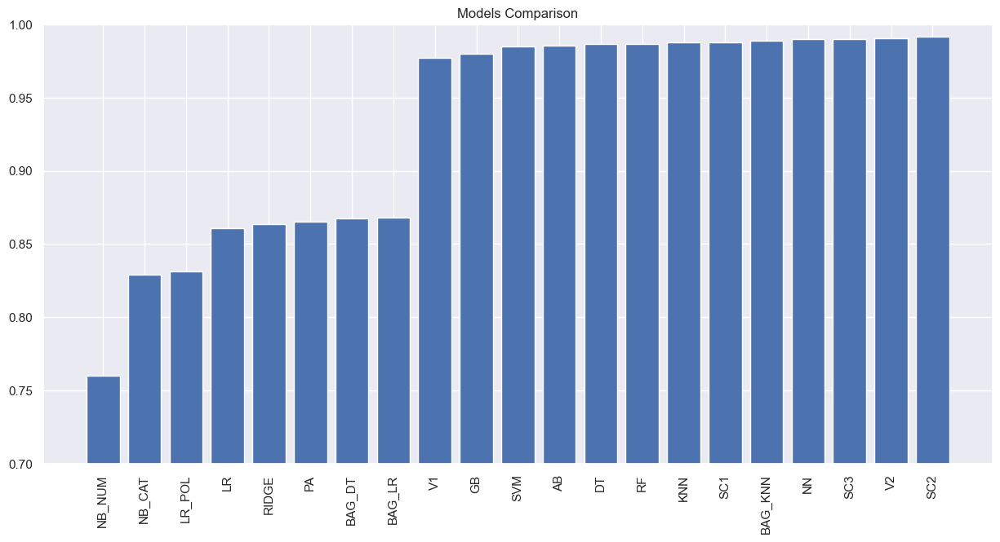

In [262]:
f1_scores = [f1_lr, f1_lr_pol, f1_nb_num, f1_nb_cat, f1_knn, f1_nn, f1_gb, f1_ab, f1_ridge, f1_pa,
            f1_dt, f1_rf, f1_bag_dt, f1_bag_knn, f1_bag_lr, f1_svm, f1_sc1, f1_sc2, f1_sc3,f1_v1,f1_v2]
models = ['LR', 'LR_POL', 'NB_NUM', 'NB_CAT', 'KNN', 'NN','GB', 'AB', 'RIDGE', 'PA', 'DT', 'RF', 'BAG_DT', 'BAG_KNN', 'BAG_LR',
         'SVM', 'SC1', 'SC2', 'SC3', 'V1', 'V2']
data_tuples = list(zip(models, f1_scores))
data = pd.DataFrame(data_tuples)
data
data = data.sort_values(1)
plt.figure(figsize=(15,7))
plt.bar(data[0], data[1])
plt.xticks(rotation=90)
plt.ylim(0.7, 1.0)
plt.title('Models Comparison')
plt.show()

<hr>
<a class="anchor" id="final_model">
    
# 8. Final Model
    
</a>

In [109]:
final_model = DecisionTreeClassifier(ccp_alpha = 0.001, criterion = 'entropy', max_depth = None, max_features = 15, 
                                  splitter = 'random', random_state = 10)

In [110]:
print('Train:' + str(avg_score(final_model, x.loc[:,feat1],y)[0]) + '\n' + 'Val:' + str(avg_score(final_model, x.loc[:,feat1],y)[1]))

Train:1.0
Val:0.9865082461734925


In [111]:
final_model = final_model.fit(x.loc[:,feat1], y)
y_pred = final_model.predict(test_data.loc[:,feat1])
kaggle_final = pd.DataFrame(y_pred, columns = ['Disease'], index = test_data.index)
kaggle_final

,Disease
PatientID,
1343,1
1727,1
1828,1
1155,1
1020,0
...,...
1000,0
1256,1
1318,0


In [112]:
kaggle_final.to_csv('Group33.csv')
# score: 1.0

In [267]:
final_model.feature_importances_

array([0.08105421, 0.06898933, 0.05601179, 0.10291003, 0.05384528,
       0.02666567, 0.05504225, 0.13104788, 0.04761906, 0.        ,
       0.20198039, 0.01039549, 0.1063023 , 0.02532927, 0.01418427,
       0.01862277])

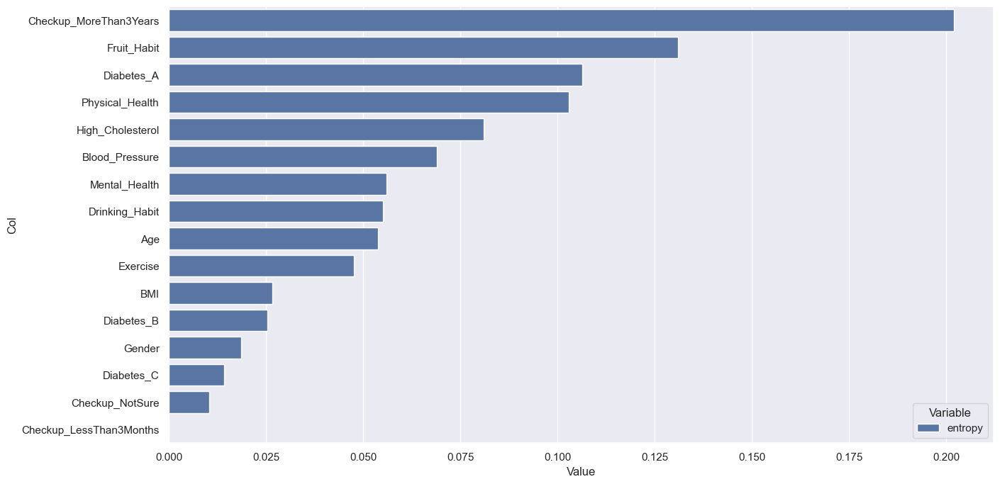

In [268]:
zippy = pd.DataFrame(final_model.feature_importances_, columns = ['entropy'])
zippy['col'] = feat1
tidy = zippy.melt(id_vars='col').rename(columns=str.title)
tidy.sort_values(['Value'], ascending = False, inplace = True)

plt.figure(figsize=(15,8))
sns.barplot(y='Col', x='Value', hue='Variable', data=tidy)
plt.show()

In [269]:
kaggle_final['Disease'].value_counts()

1    116
0    109
Name: Disease, dtype: int64

# References

https://machinelearningmastery.com/polynomial-features-transforms-for-machine-learning/
https://www.datacamp.com/tutorial/adaboost-classifier-python
https://towardsdatascience.com/hyperparameter-tuning-in-lasso-and-ridge-regressions-70a4b158ae6d
https://stackoverflow.com/questions/36268749/how-to-remove-multiple-items-from-a-list-in-just-one-statement
https://www.numpyninja.com/post/mice-algorithm-to-impute-missing-values-in-a-dataset
https://towardsdatascience.com/imputing-missing-data-with-simple-and-advanced-techniques-f5c7b157fb87
https://blog.paperspace.com/anomaly-detection-isolation-forest/
https://towardsdatascience.com/machine-learning-clustering-dbscan-determine-the-optimal-value-for-epsilon-eps-python-example-3100091cfbc
https://www.datatechnotes.com/2020/04/anomaly-detection-with-dbscan-in-python.html